In [1]:
import sys
import os
sys.path.append('/root/capsule/code/beh_ephys_analysis')
from harp.clock import decode_harp_clock, align_timestamps_to_anchor_points
from open_ephys.analysis import Session
import datetime
from aind_ephys_rig_qc.temporal_alignment import search_harp_line
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd
from pynwb import NWBFile, TimeSeries, NWBHDF5IO
from scipy.io import loadmat
from scipy.stats import zscore
import ast
from utils.plot_utils import combine_pdf_big

from open_ephys.analysis import Session
from pathlib import Path
import glob

import json
import seaborn as sns
from PyPDF2 import PdfMerger
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import re
from aind_dynamic_foraging_basic_analysis.plot.plot_foraging_session import plot_foraging_session
from aind_dynamic_foraging_data_utils.nwb_utils import load_nwb_from_filename
from hdmf_zarr.nwb import NWBZarrIO
from utils.beh_functions import session_dirs, parseSessionID, load_model_dv, makeSessionDF, get_session_tbl, get_unit_tbl, get_history_from_nwb
from utils.ephys_functions import*
from utils.ccf_utils import ccf_pts_convert_to_mm
from utils.combine_tools import apply_qc
import pandas as pd
import pickle
import scipy.stats as stats
from joblib import Parallel, delayed
from multiprocessing import Pool
from functools import partial
import time
import spikeinterface as si
import shutil 
import seaborn as sns
import math  
import seaborn as sns
from sklearn.decomposition import PCA
from scipy.stats import zscore
from trimesh import load_mesh
from scipy.optimize import minimize
from scipy.linalg import null_space
from joblib import Parallel, delayed

%matplotlib inline

In [24]:
criteria_name = 'beh_all'
waveform_version = '_raw' # 'wf_2D' for 'wf_2D_raw'

In [27]:
# load constraints and data
with open(os.path.join('/root/capsule/scratch/combined/combine_unit_tbl', 'combined_unit_tbl.pkl'), 'rb') as f:
    combined_tagged_units = pickle.load(f)
with open(os.path.join('/root/capsule/code/beh_ephys_analysis/session_combine/metrics', f'{criteria_name}.json'), 'r') as f:
    constraints = json.load(f)
wf_folder = os.path.join('/root/capsule/scratch/combined/wf_plots', criteria_name, waveform_version)
if not os.path.exists(wf_folder):
    os.makedirs(wf_folder)


In [28]:
constraints

{'isi_violations': {'bounds': [0.0, 0.1]},
 'p_max': {'bounds': [0.6, 1.0]},
 'lat_max_p': {'bounds': [0.005, 0.02]},
 'eu': {'bounds': [0.0, 0.25]},
 'corr': {'bounds': [0.95, 1.0]},
 'qc_pass': {'items': [True]},
 'peak': {'bounds': [-1000, 500]},
 'trial_count': {'bounds': [100, 2000]},
 'sig_counts': {'bounds': [4.5, 6]},
 'in_df': {'items': [True]}}

In [20]:
combined_tagged_units.loc[combined_tagged_units['tag_loc'].isnull(), 'tag_loc'] = False

In [21]:
real_neuron_mask = (combined_tagged_units['decoder']!= 'noise') & (combined_tagged_units['decoder']!='artifact') & (combined_tagged_units['qc_pass'] & (combined_tagged_units['isi_violations']<0.5))

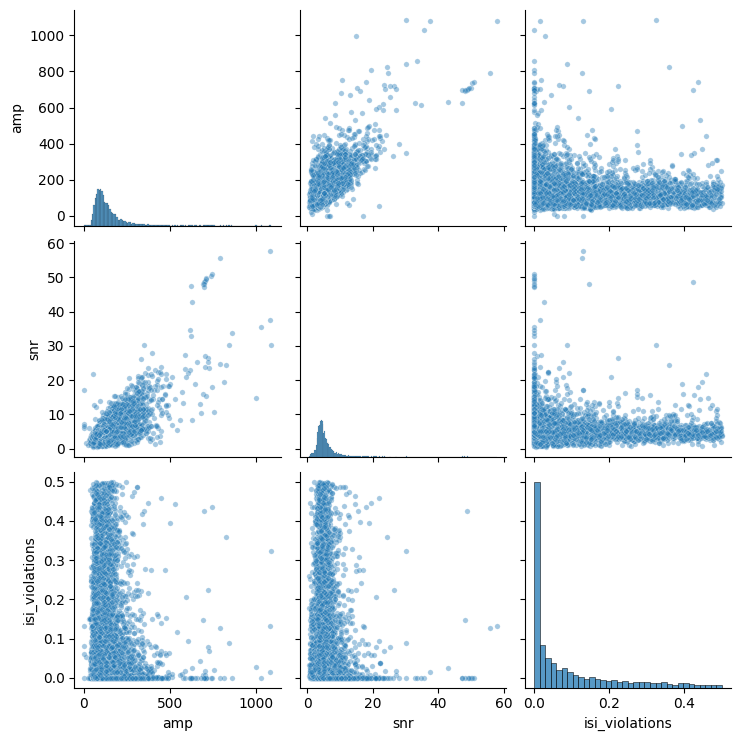

In [6]:
list_to_check = ['amp', 'snr', 'isi_violations']
sns.pairplot(combined_tagged_units[real_neuron_mask][list_to_check], plot_kws={'alpha': 0.4, 's': 15})

Applying bounds for isi_violations: [0.0, 0.1]
Applying items for qc_pass: [True]
Applying bounds for peak: [-1000, 500]
Applying bounds for trial_count: [100, 2000]
Applying items for in_df: [True]
Applying opto conditions: ['p_max', 'eu', 'corr', 'tag_loc', 'lat_max_p', 'p_mean', 'sig_counts']
Number of opto units after filtering: 119
Number of non-opto units after filtering: 2046


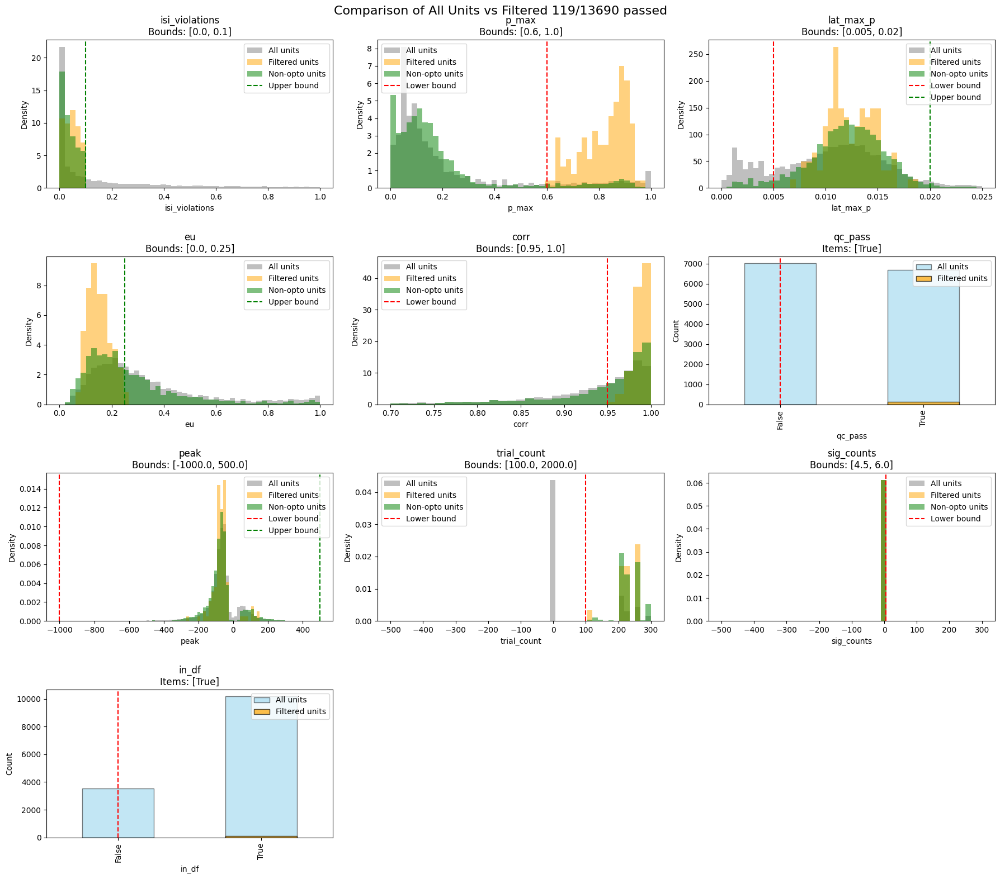

In [29]:
combined_tagged_units_filtered, combined_tagged_units, fig = apply_qc(combined_tagged_units, constraints)

In [5]:
half_opto_mask = combined_tagged_units['selected_qc_only'] & (combined_tagged_units['p_max']>=constraints['p_max']['bounds'][0])
combined_tagged_units_half_opto = combined_tagged_units[(half_opto_mask) & (~combined_tagged_units['selected'])].reset_index(drop=True)

In [9]:
# anti_cvs = '/root/capsule/code/data_management/antidromic_units.csv'
# anti_df = pd.read_csv(anti_cvs)
# data_type = 'curated'

# for i, row in combined_tagged_units_filtered.iterrows():
#     session = row['session']
#     unit = row['unit']
#     session_dir = session_dirs(session)

#     # Get list of all PDFs in opto directory
#     opto_dir = os.path.join(session_dir['ephys_fig_dir_curated'], 'waveforms_check')
#     all_pdfs = os.listdir(opto_dir)
    
#     # Find matching PDFa
#     matching_pdfs = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
#     if not matching_pdfs:
#         print(f'No wf pdf found for {session}, {unit}')
#         continue

#     pdf = matching_pdfs[0]
#     pdf_path = os.path.join(opto_dir, pdf)

#     # Copy to general opto folder
#     new_path_opto = os.path.join(opto_folder, f'{session}_{pdf}')
#     shutil.copy(pdf_path, new_path_opto)

#     # Get list of all PDFs in opto directory
#     opto_dir = session_dir[f'opto_dir_fig_{data_type}']
#     all_pdfs = os.listdir(opto_dir)
    
#     # Find matching PDF
#     matching_pdfs = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
#     if not matching_pdfs:
#         print(f'No opto pdf found for {session}, {unit}')
#         continue

#     pdf = matching_pdfs[0]
#     pdf_path = os.path.join(opto_dir, pdf)

#     # Copy to general opto folder
#     new_path_opto = os.path.join(opto_folder, f'{session}_{pdf}')
#     shutil.copy(pdf_path, new_path_opto)

#     # Copy to anti_opto_folder if anti_resp is not NaN
#     if pd.notna(row['anti_resp']):
#         new_path_opto = os.path.join(
#             anti_opto_folder,
#             f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}'
#         )
#         shutil.copy(pdf_path, new_path_opto)

#         # Check if anti unit exists
#         if anti_df.query("session == @session and unit_id == @unit").empty:
#             print(f'Error: anti unit not found in anti_df for {session}, {unit}')


In [9]:
wf_folder = '/root/capsule/scratch/combined/wf_plots/waveform_large/_raw'

In [11]:
# grab all tagged units and combine a pdf
data_type = 'curated'
target = 'soma'
opto_folder = os.path.join(wf_folder, 'opto_tagged')
wf_check_folder = os.path.join(wf_folder, 'waveforms_check')
behavior_folder = os.path.join(wf_folder, 'behavior_tagged_go_cue')
drift_folder = os.path.join(wf_folder, 'drift')
anti_opto_folder = os.path.join(wf_folder, 'anti_opto')
anti_behavior_folder = os.path.join(wf_folder, 'anti_behavior')
shutil.rmtree(opto_folder, ignore_errors=True)
shutil.rmtree(behavior_folder, ignore_errors=True)
shutil.rmtree(anti_opto_folder, ignore_errors=True)
shutil.rmtree(anti_behavior_folder, ignore_errors=True)
shutil.rmtree(drift_folder, ignore_errors=True)
shutil.rmtree(path=wf_check_folder, ignore_errors=True)

os.makedirs(name=opto_folder, exist_ok=True)
os.makedirs(name=behavior_folder, exist_ok=True)
os.makedirs(name=anti_opto_folder, exist_ok=True)
os.makedirs(name=anti_behavior_folder, exist_ok=True)
os.makedirs(name=drift_folder, exist_ok=True)
os.makedirs(name=wf_check_folder, exist_ok=True)

anti_cvs = '/root/capsule/code/data_management/antidromic_units.csv'
anti_df = pd.read_csv(anti_cvs)

for i, row in combined_tagged_units_filtered.iterrows():
    session = row['session']
    print(f'Processing session {session}, unit {row["unit"]}')
    unit = row['unit']
    session_dir = session_dirs(session)
    # opto_file
    all_pdfs = os.listdir(session_dir[f'opto_dir_fig_{data_type}'])
    pdf = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
    if len(pdf) == 0:
        print(f'No opto pdf found for {session}, {unit}')
        continue
    else:
        pdf = pdf[0]
    pdf_path = os.path.join(session_dir[f'opto_dir_fig_{data_type}'], pdf)
    # copy to new path
    new_path_opto = os.path.join(opto_folder, f'{session}_{pdf}')
    _ = shutil.copy(pdf_path, new_path_opto)   
    # if ~np.isnan(row['anti_resp']):
    #     new_path_opto = os.path.join(anti_opto_folder, f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}')
    #     _ = shutil.copy(pdf_path, new_path_opto)
    #     if anti_df.query("session == @session and unit_id == @unit").empty:
    #         print(f'Error anti unit found for {session}, {unit}')
    #     elif len(anti_df.query("session == @session and unit_id == @unit")) == 1:
    #         print(f'Correct anti unit found for {session}, {unit}')

    # selected_sessions.append(session)
    # selected_units.append(unit)
    # all_pdf.append(pdf_path)

    # behavior file: go cue
    
    # drift file
    drift_dir = os.path.join(session_dir[f'opto_dir_{data_type}'], 'drift')
    if not os.path.exists(drift_dir):
        print(f'No drift directory found for {session}, {unit}')
    else: 
        all_pdfs = os.listdir(drift_dir)
        pdf = [pdf for pdf in all_pdfs if f'{int(unit)}_drift' in pdf and pdf.endswith('.pdf')]
        if len(pdf) == 0:
            pdf = [pdf for pdf in all_pdfs if f'{int(unit)}.0_drift' in pdf and pdf.endswith('.pdf')]
            if len(pdf) == 0:
                print(f'No drift pdf found for {session}, {unit}')
                continue
            else:
                pdf=pdf[0]
        else:
            pdf = pdf[0]
        pdf_path = os.path.join(drift_dir, pdf)
        # copy to new path
        new_path_opto = os.path.join(drift_folder, f'{session}_{pdf}')
        _ = shutil.copy(pdf_path, new_path_opto)    

    # waveform file
    wf_dir = os.path.join(session_dir['ephys_fig_dir_curated'], 'waveforms_check')
    if not os.path.exists(wf_dir):
        print(f'No waveform directory found for {session}, {unit}')
    else: 
        all_pdfs = os.listdir(wf_dir)
        pdf = [pdf for pdf in all_pdfs if f'{int(unit)}_waveforms' in pdf and pdf.endswith('.pdf')]
        if len(pdf) == 0:
            pdf = [pdf for pdf in all_pdfs if f'{int(unit)}.0_waveforms' in pdf and pdf.endswith('.pdf')]
            if len(pdf) == 0:
                print(f'No waveform pdf found for {session}, {unit}')
                continue
            else:
                pdf=pdf[0]
        else:
            pdf = pdf[0]
        pdf_path = os.path.join(wf_dir, pdf)
        # copy to new path
        new_path_opto = os.path.join(wf_check_folder, f'{session}_{pdf}')
        _ = shutil.copy(pdf_path, new_path_opto)

 
    if row['in_df']:
        beh_dir = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue')
        if not os.path.exists(beh_dir):
            print(f'No go_cue directory found for {session}, {unit}')
        else: 
            all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue'))
            pdf = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
            if len(pdf) == 0:
                print(f'No go_cue pdf found for {session}, {unit}')
                continue
            else:
                pdf = pdf[0]
            pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response', pdf)
            # copy to new path
            new_path_ephys = os.path.join(behavior_folder, f'{session}_{pdf}')
            _ = shutil.copy(pdf_path, new_path_ephys)

        # if ~np.isnan(row['anti_resp']):
        #     new_path_ephys = os.path.join(anti_behavior_folder, f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}')
        #     _ = shutil.copy(pdf_path, new_path_ephys)


Processing session ecephys_713854_2024-03-05_13-01-09, unit 167.0
Processing session ecephys_713854_2024-03-05_13-01-09, unit 169.0
Processing session ecephys_713854_2024-03-05_13-31-20, unit 18.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 32.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 44.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 45.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 55.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 62.0
Processing session ecephys_717120_2024-03-06_12-54-27, unit 66.0
Processing session ecephys_717120_2024-03-07_12-12-02, unit 6.0
Processing session ecephys_717120_2024-03-07_12-12-02, unit 38.0
Processing session ecephys_717120_2024-03-07_12-12-02, unit 51.0
Processing session ecephys_717120_2024-03-07_12-12-02, unit 55.0
Processing session ecephys_717120_2024-03-07_12-12-02, unit 120.0
Processing session ecephys_713854_2024-03-08_15-43-01, unit 20.0
Processing session beha

In [12]:
combine_pdf_big(os.path.join(wf_folder, 'opto_tagged'), os.path.join(wf_folder, 'opto_combined.pdf'))
# combine_pdf_big(os.path.join(wf_folder, 'behavior_tagged_response'), os.path.join(wf_folder, 'behavior_combined.pdf'))
# combine_pdf_big(os.path.join(wf_folder, 'drift'), os.path.join(wf_folder, 'drift_combined.pdf'))
# combine_pdf_big(os.path.join(wf_folder, 'waveforms_check'), os.path.join(wf_folder, 'waveforms_check_combined.pdf'))
# combine_pdf_big(os.path.join(wf_folder, 'behavior_tagged_response'), os.path.join(wf_folder, 'behavior_combined.pdf'))

Processing 112 files in /root/capsule/scratch/combined/wf_plots/waveform_large/_raw/opto_tagged


Combined PDF saved as: /root/capsule/scratch/combined/wf_plots/waveform_large/_raw/opto_combined.pdf


In [13]:
# g = sns.pairplot(
#         combined_tagged_units[['isi_violations', 'p_max', 'selected', 'peak', 'amp', 'lat_max_p', 'eu', 'corr']],
#         hue='selected',
#         corner=True,
#         diag_kind='auto',
#         # plot_kws={'alpha': 0.5, 's': 5}, # 'linewidth': 2, 'facecolor': 'none'},
#         diag_kws={'common_norm': False}
#     )

# # save
# g.fig.suptitle(f'Pairplot of {criteria_name} units', y=1.02, fontsize=16)
# g.savefig(os.path.join(wf_folder, f'Pass_pairplot_{criteria_name}.pdf'))


In [9]:
# Extract waveform feature
wf_norm = []
wf_2D_norm = []

half_w = []
trough_w = []
pre_half = []
post_half = []
post_w = []

trough_post_ratio_1D = []
trough_pre_ratio_1D = []

post_slope = []
post_space = []
pre_slope = []
pre_space = []

symmetry_inte = []
symmetry_half = []
symmetry_slope = []
symmetry_inte_div = []
symmetry_half_div = []
symmetry_slope_div = []


# wf_norm = combined_tagged_units_filtered['wf']/np.abs(combined_tagged_units_filtered['peak'])
# wf_2D_norm = combined_tagged_units_filtered['wf_2d']/np.abs(combined_tagged_units_filtered['peak'])

wf_norm = combined_tagged_units_filtered[f'wf{waveform_version}']/np.abs(combined_tagged_units_filtered[f'peak{waveform_version}'])
wf_2D_norm = combined_tagged_units_filtered[f'wf_2d{waveform_version}']/np.abs(combined_tagged_units_filtered[f'peak{waveform_version}'])
for rows in combined_tagged_units_filtered.iterrows():
    print(f'Processing unit {rows[1]["unit"]} of session {rows[1]["session"]}')
    # wf = rows[1]['wf']
    # peak = rows[1]['peak']
    # print(rows[1]['session'])
    # print(rows[1]['unit'])
    if rows[0]==109:
        print(rows[0])
    wf = rows[1][f'wf{waveform_version}']
    peak = rows[1]['peak_raw']
    peak_ind = np.argmin(wf)

    if np.abs(wf[0]-wf[-1])>50:
        half_w.append(np.nan)  # half width in samples
        trough_w.append(np.nan)  # trough width in samples
        post_w.append(np.nan)  # post trough width in samples
        pre_half.append(np.nan)
        post_half.append(np.nan)
        trough_post_ratio_1D.append(np.nan)
        trough_pre_ratio_1D.append(np.nan)
        post_slope.append(np.nan)
        post_space.append(np.nan)
        pre_slope.append(np.nan)
        pre_space.append(np.nan)
        symmetry_inte.append(np.nan)
        symmetry_half.append(np.nan)
        symmetry_slope.append(np.nan)
        symmetry_inte_div.append(np.nan)
        symmetry_half_div.append(np.nan)
        symmetry_slope_div.append(np.nan)
        continue

    if peak<0:
        curr_trough_loc = np.argmax(wf[peak_ind:])+1
        post_trough = np.max(wf[peak_ind:])
        post_trough_ind = np.argmax(wf[peak_ind:])+1
        pre_trough = np.max(wf[:peak_ind])
        pre_trough_ind = peak_ind - np.argmax(wf[:peak_ind])  
    else:
        curr_trough_loc = np.argmin(wf[peak_ind:])+1
        post_trough = np.min(wf[peak_ind:])
        post_trough_ind = np.argmin(wf[peak_ind:])+1
        pre_trough = np.min(wf[:peak_ind])
        pre_trough_ind = peak_ind - np.argmin(wf[:peak_ind])  
    curr_trough_post = post_trough/peak # positive if same sign, negative if opposite sign
    curr_trough_pre = pre_trough/peak # positive if same sign, negative if opposite sign
    curr_trough_loc_slope_post = (post_trough/peak)/post_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_inte_post = ((peak - pre_trough)/peak)*post_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_slope_pre = ((peak - pre_trough)/peak)/pre_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_inte_pre = ((peak - post_trough)/peak)*pre_trough_ind # positive if same sign, negative if opposite sign

    curr_symmetry_inte = curr_trough_loc_inte_post - curr_trough_loc_inte_pre  # positive if same sign, negative if opposite sign
    curr_symmetry_slope = curr_trough_loc_slope_post - curr_trough_loc_slope_pre  # positive if same sign, negative if opposite sign
    
    

    # find samples where the waveform crosses the half peak threshold to infer half width
    half_peak = peak / 2
    wf_half_crossings = np.where(np.diff(np.sign(wf - half_peak))!=0)[0]
    if len(wf_half_crossings) < 2:
        post_crossing = 0
        pre_crossing = 0
    else: 
        post_crossing = np.min(wf_half_crossings[wf_half_crossings > peak_ind]) - peak_ind
        pre_crossing = peak_ind - np.max(wf_half_crossings[wf_half_crossings < peak_ind])

    half_w.append(post_crossing + pre_crossing)  # half width in samples
    trough_w.append(post_trough_ind + pre_trough_ind)  # trough width in samples
    post_w.append(post_trough_ind)  # post trough width in samples
    pre_half.append(pre_crossing)
    post_half.append(post_crossing)

    trough_post_ratio_1D.append(curr_trough_post)
    trough_pre_ratio_1D.append(curr_trough_pre)

    post_slope.append(curr_trough_loc_slope_post)
    post_space.append(curr_trough_loc_inte_post)
    pre_slope.append(curr_trough_loc_slope_pre)
    pre_space.append(curr_trough_loc_inte_pre)

    symmetry_inte.append(curr_trough_loc_inte_post - curr_trough_loc_inte_pre)
    symmetry_half.append(post_crossing - pre_crossing)
    symmetry_slope.append(curr_trough_loc_slope_post - curr_trough_loc_slope_pre)

    symmetry_inte_div.append(curr_trough_loc_inte_post/curr_trough_loc_inte_pre)
    symmetry_half_div.append(post_crossing/pre_crossing)
    symmetry_slope_div.append(curr_trough_loc_slope_post/curr_trough_loc_slope_pre)


wf_features = pd.DataFrame({'unit_id': combined_tagged_units_filtered['unit'],
                            'session': combined_tagged_units_filtered['session'],
                            'amp': combined_tagged_units_filtered['amp'],
                            'peak': combined_tagged_units_filtered['peak'],
                            'half_w': half_w,
                            'trough_w': trough_w,
                            'pre_half': pre_half,
                            'post_half': post_half,
                            'post_w': post_w,
                            'trough_post_ratio_1D': trough_post_ratio_1D,
                            'trough_pre_ratio_1D': trough_pre_ratio_1D,
                            'post_slope': post_slope,
                            'post_space': post_space,
                            'pre_slope': pre_slope,
                            'pre_space': pre_space,
                            'symmetry_inte': symmetry_inte,
                            'symmetry_half': symmetry_half,
                            'symmetry_slope': symmetry_slope,
                            'symmetry_inte_div': symmetry_inte_div,
                            'symmetry_half_div': symmetry_half_div,
                            'symmetry_slope_div': symmetry_slope_div,
                            'y_loc': combined_tagged_units_filtered['y_loc'],
                            'probe': combined_tagged_units_filtered['probe'],
                            })
                            


Processing unit 167.0 of session ecephys_713854_2024-03-05_13-01-09
Processing unit 169.0 of session ecephys_713854_2024-03-05_13-01-09
Processing unit 18.0 of session ecephys_713854_2024-03-05_13-31-20
Processing unit 32.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 44.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 45.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 55.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 62.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 66.0 of session ecephys_717120_2024-03-06_12-54-27
Processing unit 6.0 of session ecephys_717120_2024-03-07_12-12-02
Processing unit 38.0 of session ecephys_717120_2024-03-07_12-12-02
Processing unit 51.0 of session ecephys_717120_2024-03-07_12-12-02
Processing unit 55.0 of session ecephys_717120_2024-03-07_12-12-02
Processing unit 120.0 of session ecephys_717120_2024-03-07_12-12-02
Processing unit 20.0 of session ecephys_713854_2024-03-08_15

In [15]:
post_crossing = np.min(wf_half_crossings[wf_half_crossings > peak_ind]) - peak_ind

In [16]:
peak_ind

np.int64(30)

In [17]:
wf_list = combined_tagged_units_filtered[f'wf{waveform_version}'].values
peak_list = combined_tagged_units_filtered[f'peak{waveform_version}'].values

# Stack waveforms into 2D array (n_units x n_timepoints)
wf_array = np.vstack(wf_list)

# Normalize each row by corresponding peak value
wf_norm = wf_array / peak_list[:, np.newaxis]  # shape: (n_units, n_timepoints)


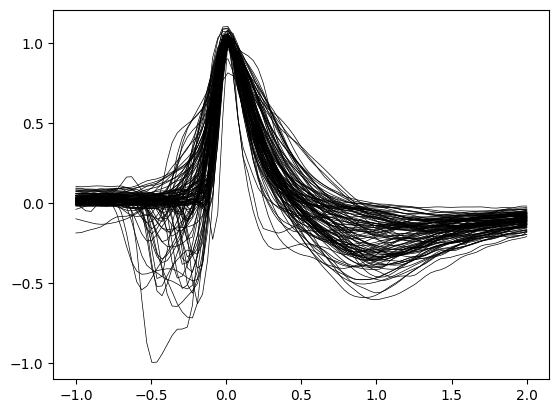

In [18]:
time = np.linspace(-1, 2, wf_norm.shape[1])  # Assuming time is from -0.5 to 0.5 seconds
plt.plot(time, wf_norm.T, c = 'k', linewidth = 0.5);

In [19]:
# g = sns.pairplot(wf_features, corner=False, 
#              plot_kws={'alpha': 0.5, 's': 10},
#             #  hue='probe'
#              )
# # save figure
# # title = f"{len(wf_features)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
# # g.fig.suptitle(title, y=1.02)
# g.savefig(os.path.join(wf_folder, f'Wf_features_pairplot_{criteria_name}.png'), dpi=300)

In [20]:
# ncols = 8
# nrows = int(np.ceil(len(combined_tagged_units_filtered) / ncols))
# features = ['amp', 'peak', 'trough_post_ratio_1D', 'fall_slope', 'fall_space', 'symmetry']
# for feature in features:
#     if feature not in combined_tagged_units_filtered.columns:
#         continue
#     focus = combined_tagged_units_filtered[feature].values
#     resorted = combined_tagged_units_filtered.sort_values(by=feature, ascending=False).reset_index(drop=True)
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 2*nrows))
#     for i, row in resorted.iterrows():
#         ax = axes[i // ncols, i % ncols]
#         wf = row['wf']
#         peak = row['peak']
#         ax.plot(wf/np.abs(peak), color='blue')
#         # remove x and y axis
#         ax.axis('off')
#         ax.set_title(f'{row[feature]:.2f}')
#     plt.suptitle(feature, fontsize=16)
#     plt.tight_layout()
#     fig.savefig(fname=os.path.join(wf_folder, f'{feature}_wf.png'), dpi=300, bbox_inches='tight')

In [21]:
# cell_ind =25
# time = (np.arange(90)-30)*(1000/30000)
# plt.plot(time, -wf_norm[cell_ind], linewidth=7, color='k')
# plt.xlabel('Time (ms)')
# plt.axhline(y=0, color='k', linestyle='--', linewidth=1)
# plt.xlim()
# # 
# ind = np.argmin(np.abs(wf_norm[cell_ind][30:]+trough_post_ratio_1D[cell_ind])) + 30
# # plt.axhline(trough_post_ratio_1D[cell_ind], color='r', linestyle='--', linewidth=5)
# plt.plot([time[ind], time[ind]], [0, trough_post_ratio_1D[cell_ind]], color='r', linewidth=5)
# # plt.scatter(ind[0]*(1000/30000), trough_post_ratio_1D[0])
# # turn off box
# plt.gca().spines['top'].set_visible(False)
# plt.gca().spines['right'].set_visible(False)
# plt.gca().spines['left'].set_visible(False)
# plt.gca().spines['bottom'].set_visible(False)
# plt.savefig(os.path.join(wf_folder, f'{cell_ind}_wf_AHP.pdf'), dpi=300, bbox_inches='tight')


In [22]:
# grab all tagged units and combine spike waveforms
data_type = 'curated'
target = 'soma'
selected_sessions = []
selected_units = []
all_pdf = []
all_wfs = []
all_peaks = []
curr_session = None

all_wfs = combined_tagged_units_filtered[f'wf{waveform_version}'].tolist()
# all_wfs_aligned = combined_tagged_units_filtered['wf_aligned'].tolist()
all_peaks = combined_tagged_units_filtered[f'peak{waveform_version}'].tolist()

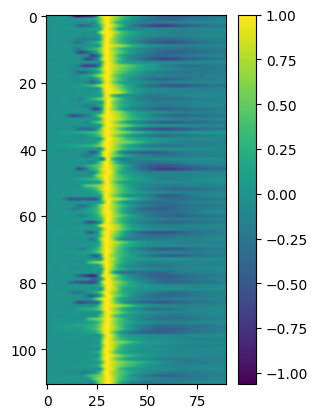

In [23]:
all_wfs = np.array(all_wfs)
# all_wfs_aligned = np.array(all_wfs_aligned)
baseline = np.mean(all_wfs[:, :3], axis=1, keepdims=True) 
peaks = np.array(all_peaks).reshape(-1, 1) 

all_wfs_nl = (all_wfs - baseline) / ((np.squeeze(all_wfs[:, 30]) - np.squeeze(baseline))[:, np.newaxis])
all_wfs_nl_raw = all_wfs/all_wfs[:,30][:, np.newaxis]
all_wfs_nl[all_wfs_nl_raw[:, 0]>1, :] = np.nan  # remove bad waveforms
# all_wfs_aligned_nl = all_wfs_aligned/all_wfs_aligned[:,30].reshape(-1, 1)

ax = plt.subplot(1, 2, 1)
plt.imshow(all_wfs_nl, aspect='auto', cmap='viridis')
plt.colorbar()
# ax = plt.subplot(1, 2, 2)
# plt.imshow(all_wfs_aligned_nl, aspect='auto', cmap='viridis')
# plt.colorbar()

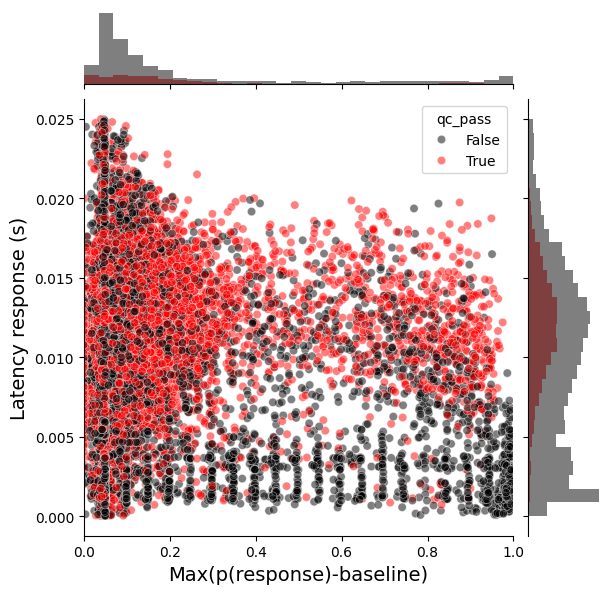

In [13]:
# Define color palette for groups
palette = {True: "red", False: "k"}

# Create JointGrid
g = sns.JointGrid(data=combined_tagged_units, x='p_max', y='lat_max_p', hue='qc_pass', palette=palette)

# Add scatter plot in the center
g.plot_joint(sns.scatterplot, alpha=0.5)
g.ax_joint.set_xlim(0, 1)
g.ax_joint.set_xlabel('Max(p(response)-baseline)', fontsize=14)
g.ax_joint.set_ylabel('Latency response (s)', fontsize=14)

# Add histograms manually for each group
p_max_bins = np.linspace(0, 1, 30)
lat_max_p_bins = np.linspace(combined_tagged_units['lat_max_p'].min(), combined_tagged_units['lat_max_p'].max(), 30)
for qc_val, color in palette.items():
    subset = combined_tagged_units[combined_tagged_units['selected_qc_only'] == qc_val]
    
    # Horizontal histogram for x-axis (default orientation)
    sns.histplot(subset['p_max'], ax=g.ax_marg_x, bins=p_max_bins, color=color, alpha=0.5, edgecolor='none')

    # **VERTICAL histogram for y-axis** using orientation="horizontal"
    sns.histplot(y=subset['lat_max_p'], ax=g.ax_marg_y, bins=lat_max_p_bins, color=color, alpha=0.5, edgecolor='none')

plt.savefig(os.path.join(wf_folder, f'qc_pass_p_max_lat_max_p_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')
# Show plot
plt.show()



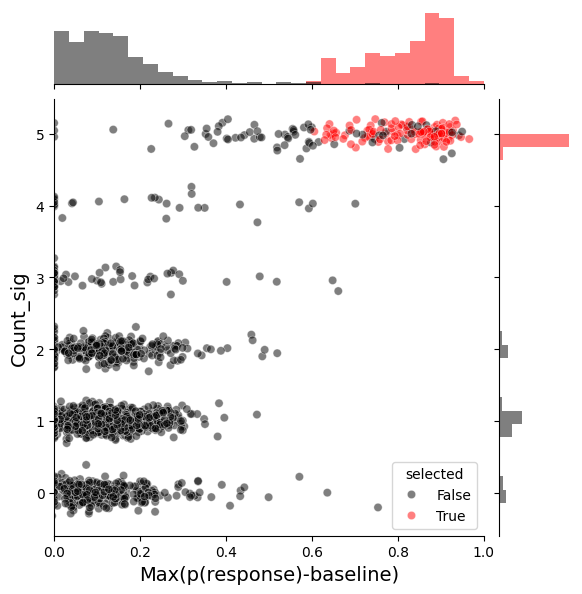

In [30]:
# opto tagged vs not
# Define color palette for groups
palette = {True: "r", False: "k"}
x_col = 'p_max'
y_col = 'sig_counts'

combined_tagged_units_plot = combined_tagged_units.copy()
combined_tagged_units_plot[y_col] = combined_tagged_units_plot[y_col]  + np.random.normal(0, 0.1, size=len(combined_tagged_units_plot[y_col]))  # add jitter to y-axis for better visibility

# Create JointGrid
g = sns.JointGrid(data=combined_tagged_units_plot[combined_tagged_units['selected_qc_only']], x=x_col, y=y_col, hue='selected', palette=palette)

# Add scatter plot in the center
g.plot_joint(sns.scatterplot, alpha=0.5)
g.ax_joint.set_xlim(0, 1)
g.ax_joint.set_xlabel('Max(p(response)-baseline)', fontsize=14)
g.ax_joint.set_ylabel('Count_sig', fontsize=14)

# Add histograms manually for each group
p_max_bins = np.linspace(0, 1, 30)
y_bins = np.linspace(combined_tagged_units_plot[combined_tagged_units['selected_qc_only']][y_col].min(), combined_tagged_units[combined_tagged_units['selected_qc_only']][y_col].max(), 30)
for qc_val, color in palette.items():
    subset = combined_tagged_units_plot[combined_tagged_units['selected_qc_only'] & (combined_tagged_units['selected'] == qc_val)]
    # Horizontal histogram for x-axis (default orientation)
    ax = g.ax_marg_x
    ax.hist(subset[x_col], bins=p_max_bins, color=color, alpha=0.5, edgecolor='none', density='True')

    # **VERTICAL histogram for y-axis** using orientation="horizontal"
    ax = g.ax_marg_y
    ax.hist(subset[y_col], bins=y_bins, color=color, alpha=0.5, edgecolor='none', density='True',  orientation='horizontal')
    # sns.histplot(y=subset['lat_max_p'], ax=g.ax_marg_y, bins=lat_max_p_bins, color=color, alpha=0.5, edgecolor='none')

plt.savefig(os.path.join(wf_folder, f'opto_pass_{x_col}_{y_col}_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')
# Show plot
plt.show()



In [26]:
combined_tagged_units_filtered.columns

Index(['session', 'unit', 'qc_pass', 'opto_tagged', 'opto_tagging_pre',
       'opto_tagging_post', 'anti', 'in_df', 'trial_count', 'p_max', 'p_mean',
       'lat_max_p', 'isi_violations', 'snr', 'eu', 'corr', 'amp', 'amp_raw',
       'peak', 'peak_raw', 'wf', 'wf_raw', 'wf_aligned', 'wf_2d', 'wf_2d_raw',
       'probe', 'y_loc', 'rec_side', 'top', 'bottom', 'tag_loc', 'fr',
       'decoder', 'peak_channel_ind', 'all_p_max', 'all_p_mean',
       'all_lat_max_p', 'all_corr', 'all_eu', 'x_ccf', 'y_ccf', 'z_ccf',
       'selected_qc_only', 'selected_opto_only'],
      dtype='object')

In [27]:
combined_tagged_units_filtered.groupby(['probe', 'in_df']).size().reset_index(name='count')


,probe,in_df,count
0,2,False,16
1,2,True,95


In [28]:
# pca for waveform
# Perform PCA on the waveforms
# amp_thresh = -50
# wf_mat = zscore(all_wfs_nl[np.array(all_peaks)<amp_thresh], axis=0, nan_policy='omit')  # z-score normalize the waveforms
# wf_mat = np.delete(wf_mat, 30, axis=1)
# plt.imshow(wf_mat, aspect='auto', cmap='viridis')
# plt.colorbar(label='Normalized Amplitude')
all_wfs_nl_clean = all_wfs_nl[~np.isnan(all_wfs_nl[:,0])]


In [29]:
pca = PCA(n_components=8)
pc_time = (np.arange(90) - 30)/30000 * 1000  # assuming 90 samples in the waveform
pca_result = pca.fit_transform(all_wfs_nl_clean)
explained_variance = pca.explained_variance_ratio_
coeff = pca.components_
mean = pca.mean_
all_wfs_pc = pca.inverse_transform(pca_result)

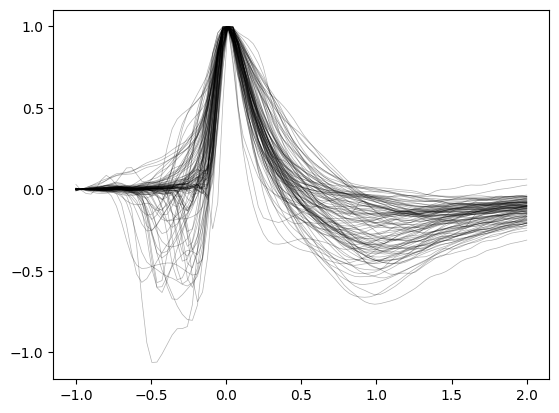

In [30]:
time = np.linspace(-1, 2, 90)
plt.plot(time, all_wfs_nl_clean.T, 'k', linewidth=0.5, alpha=0.3);

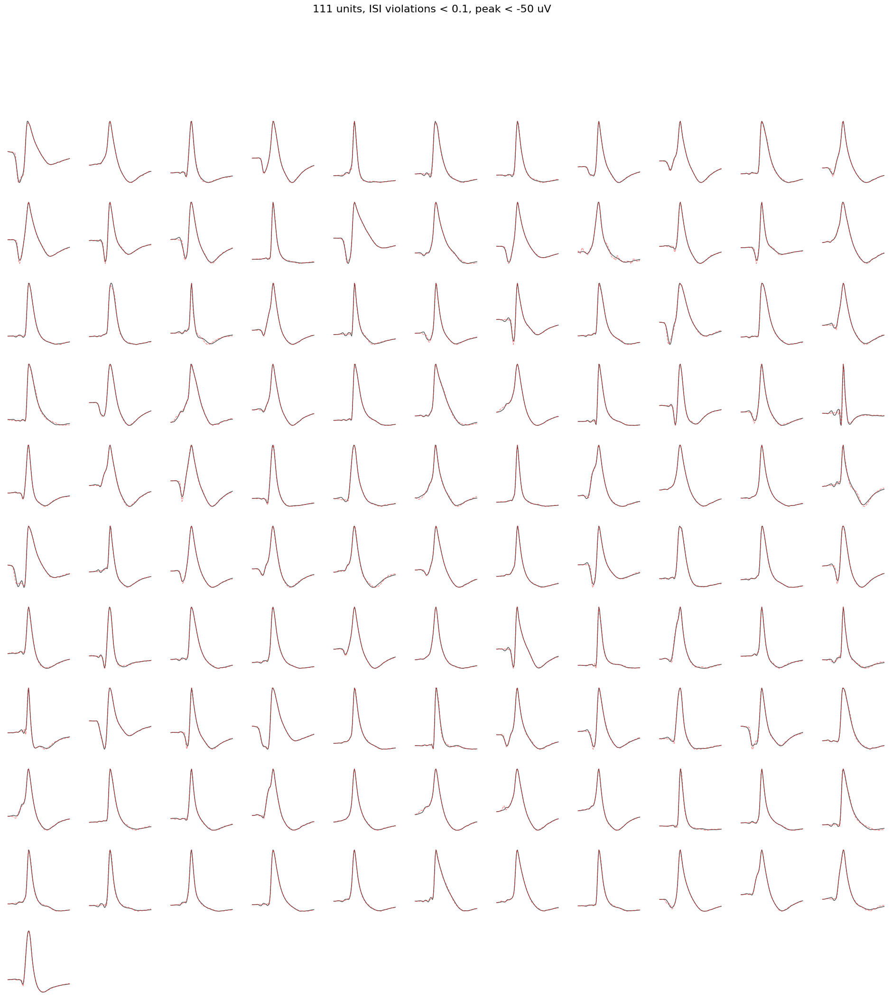

In [31]:
fig = plt.figure(figsize=(24, 24))
gs = gridspec.GridSpec(int(np.ceil(np.sqrt(len(all_wfs_nl_clean)))), int(np.ceil(np.sqrt(len(all_wfs_nl_clean)))), figure=fig)
for i in range(len(all_wfs_nl_clean)):
    ax = fig.add_subplot(gs[i])
    plt.plot(pc_time, all_wfs_pc[i], alpha=0.7, color='k', linewidth=1);
    plt.plot(pc_time, all_wfs_nl_clean[i], color='r', alpha=0.5, linestyle='--', linewidth=1)
    # turn off the axis
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)    
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.suptitle(title, fontsize=16)
plt.savefig(fname=os.path.join(wf_folder, f'All-wf_{criteria_name}.pdf'))


In [32]:
# perform PCA
wf_mat = zscore(all_wfs_nl_clean, axis=0).copy()
wf_mat = np.delete(wf_mat, 30, axis=1)  # remove the peak sample to avoid bias in PCA
# wf_mat = wf_mat[:, 2:-2]
# wf_mat = zscore(all_wfs_nl_clean, axis=0)  # z-score normalize the waveforms
# wf_mat = np.delete(wf_mat, 20, axis=1)  # remove the peak sample to avoid bias in PCA
pca = PCA(n_components=5)  # we can choose the number of components we want
pca_result = pca.fit_transform(wf_mat)
explained_variance = pca.explained_variance_ratio_


/tmp/ipykernel_5830/492994524.py:2: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  wf_mat = zscore(all_wfs_nl_clean, axis=0).copy()


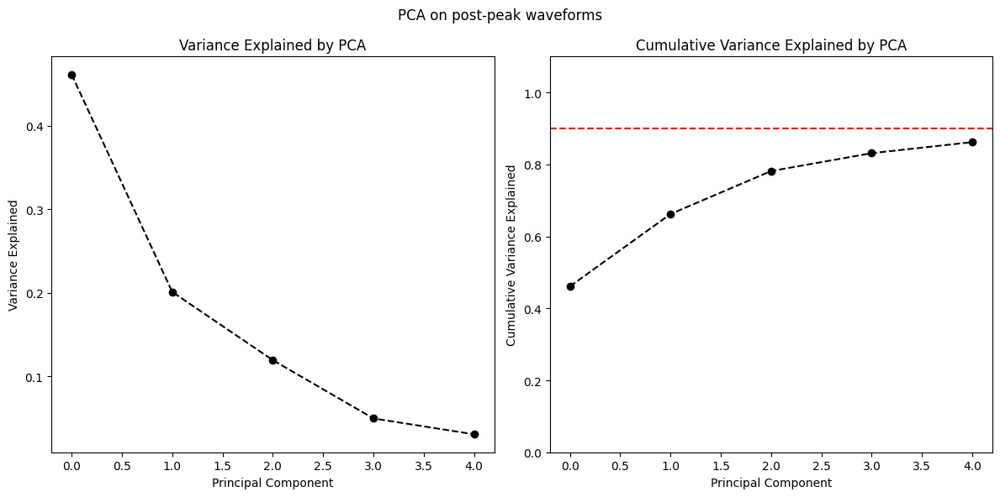

In [33]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
axes[0].plot(pca.explained_variance_ratio_, marker='o', linestyle='--', color='black')
axes[0].set_xlabel('Principal Component')
axes[0].set_ylabel('Variance Explained')
axes[0].set_title('Variance Explained by PCA')
axes[1].plot(np.cumsum(pca.explained_variance_ratio_), marker='o', linestyle='--', color='black')
axes[1].axhline(0.9, color='red', linestyle='--', label='90% Variance')
axes[1].set_ylim(0, 1.1)
axes[1].set_xlabel('Principal Component')
axes[1].set_ylabel('Cumulative Variance Explained')
axes[1].set_title('Cumulative Variance Explained by PCA')
plt.suptitle('PCA on post-peak waveforms')
plt.tight_layout()

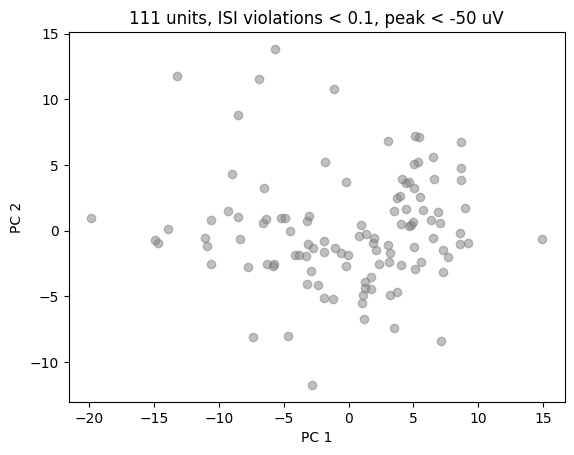

In [34]:
# score = 0.2*pca_result[:, 0] + pca_result[:, 1]
# score = pca_result[:, 0]
score = pca_result[:, 0]
# score = pca_result[:, 0] + pca_result[:, 2]
filter = score > 20
pc1 = 0
pc2 = 1
plt.scatter(pca_result[filter, pc1], pca_result[filter, pc2], c = 'k', alpha=0.7)
plt.scatter(pca_result[~filter, pc1], pca_result[~filter, pc2], c = 'gray', alpha=0.5)
plt.xlabel('PC 1')
plt.ylabel('PC 2')
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.title(title)
plt.savefig(fname=os.path.join(wf_folder, f'pca_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [35]:
# kmeans clustering in PC1
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


focus_pcs = pca_result[:, 0:2]
# focus_pcs = focus_pcs.reshape(-1, 1)

# Perform KMeans clustering (e.g., into 2 clusters)
# loop through random states 0 to 50 and pick best separation in kmeans
inertias = []
sil_scores = []
for random_state in range(50):
    kmeans = KMeans(n_clusters=2, random_state=random_state)
    clusters = kmeans.fit_predict(focus_pcs)
    inertia = kmeans.inertia_
    sil_score = silhouette_score(focus_pcs, clusters)
    inertias.append(inertia)
    sil_scores.append(sil_score)

rand_ind_max = np.argmin(np.array(inertias))
rand_ind_max = np.argmax(np.array(sil_scores))
print(f'inter {np.min(np.array(inertias))}')
print(f'sil {np.max(np.array(sil_scores))}')
kmeans = KMeans(n_clusters=2, random_state=rand_ind_max)
clusters = kmeans.fit_predict(focus_pcs)
print(f'Best random state: {rand_ind_max}')
print(f'Intertia: {kmeans.inertia_}')
print(f'Silhouette score: {silhouette_score(focus_pcs, clusters)}')

inter 3355.3820208090933
sil 0.44374276955868375
Best random state: 1
Intertia: 3356.6183601611738
Silhouette score: 0.44374276955868375


In [36]:
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
import numpy as np

focus_pcs = pca_result[:, 0:2]
# focus_pcs = pca_result[:, 0:2].reshape(-1, 1)

log_likelihoods = []
sil_scores = []

for random_state in range(100):
    gmm = GaussianMixture(n_components=2, random_state=random_state, covariance_type='full')
    gmm.fit(focus_pcs)
    clusters = gmm.predict(focus_pcs)
    log_likelihoods.append(gmm.score(focus_pcs) * len(focus_pcs))  # total log-likelihood
    sil_scores.append(silhouette_score(focus_pcs, clusters))

# Use silhouette to select best
best_seed = np.argmax(sil_scores)
print(f'Best seed: {best_seed}')
print(f'Log-likelihood: {log_likelihoods[best_seed]}')
print(f'Silhouette score: {sil_scores[best_seed]}')

# Fit final model with best seed
gmm = GaussianMixture(n_components=2, random_state=best_seed, covariance_type='full')
gmm.fit(focus_pcs)
clusters = gmm.predict(focus_pcs)
mean1, mean2 = gmm.means_  # shape: (2, 2)

# Direction vector from one mean to the other
direction = mean2 - mean1
direction /= np.linalg.norm(direction)


Best seed: 5
Log-likelihood: -668.613011218308
Silhouette score: 0.44374276955868375


[ 0.99986899 -0.01618635]


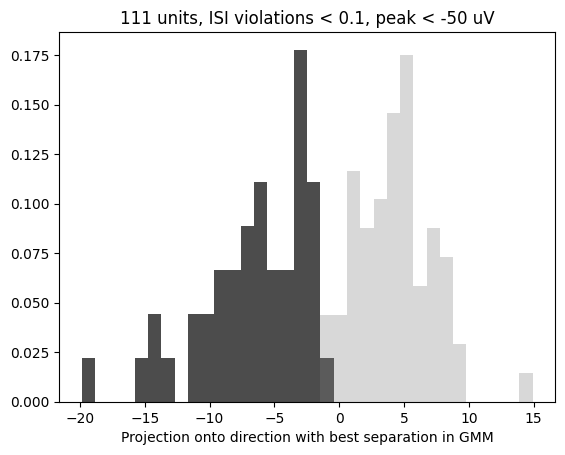

In [37]:
# clusters is a 1D array of cluster labels (0 or 1)
# score = direction[0] * focus_pcs[:, 0] + direction[1] * focus_pcs[:, 1]
score = np.dot(focus_pcs, direction)
bins = np.linspace(np.min(score), np.max(score), 40)
plt.hist(score[clusters==0], bins=bins, color='k', alpha=0.7, density=True);
plt.hist(score[clusters==1], bins=bins, color='gray', alpha=0.3, density=True);
plt.xlabel('Projection onto direction with best separation in GMM')
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.title(title)
plt.savefig(fname=os.path.join(wf_folder, f'Projection_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')
print(direction)

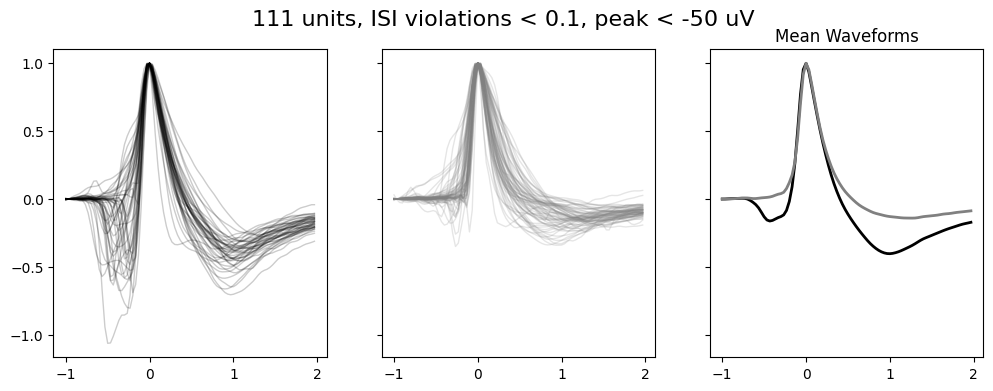

In [38]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4), sharey=True)  # sharey links y-axis

wf_time = (np.arange(90) - 30) / 30000 * 1000  # waveform time in ms

# Plot 1: Cluster 1
axs[0].plot(wf_time, all_wfs_nl_clean[clusters==0].T, alpha=0.2, linewidth=1, color='k')

# Plot 2: Cluster 2
axs[1].plot(wf_time, all_wfs_nl_clean[clusters==1].T, alpha=0.2, linewidth=1, color=[0.5, 0.5, 0.5])

# Plot 3: Means
axs[2].plot(wf_time, np.mean(all_wfs_nl_clean[clusters==0], axis=0), linewidth=2, color='k')
axs[2].plot(wf_time, np.mean(all_wfs_nl_clean[clusters==1], axis=0), linewidth=2, color=[0.5, 0.5, 0.5])
axs[2].set_title('Mean Waveforms')

# Super title
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
fig.suptitle(title, fontsize=16)

# Save figure
plt.savefig(os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


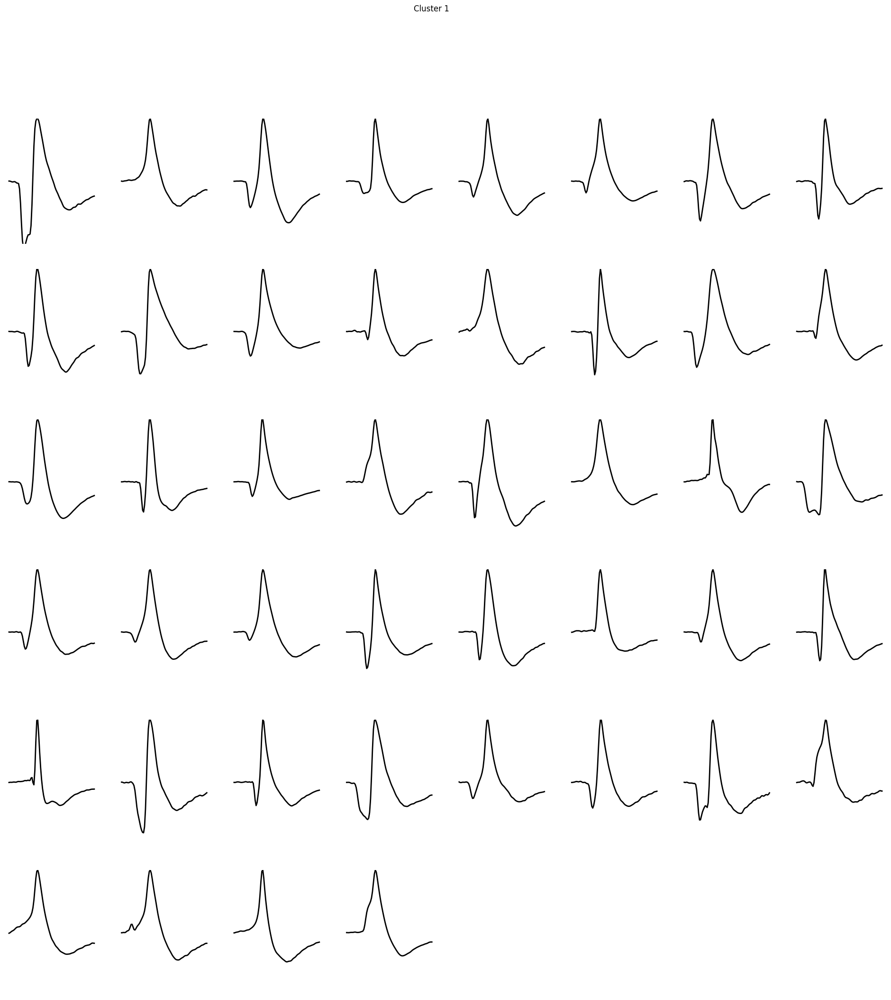

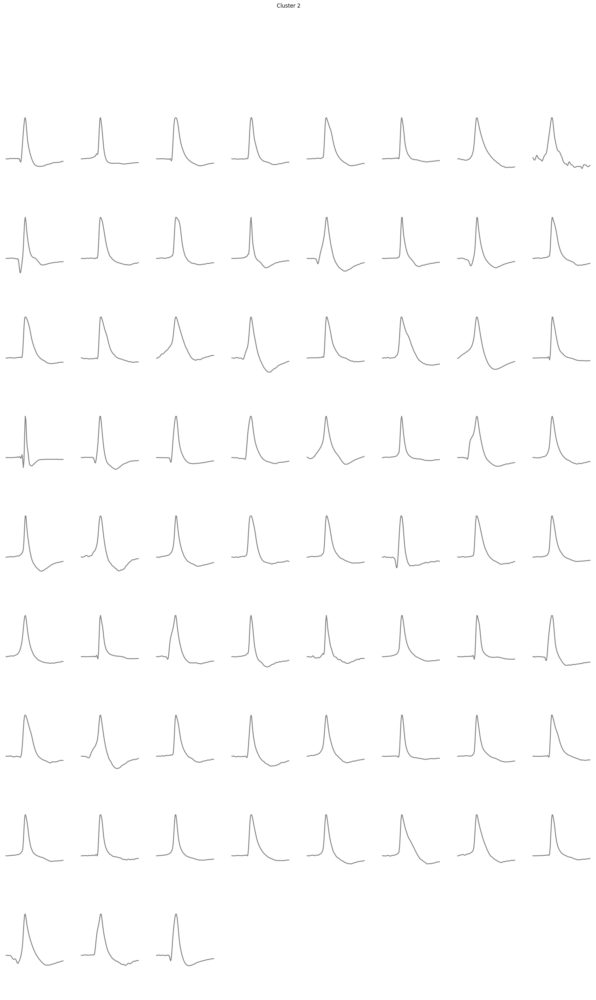

In [39]:
fig = plt.figure(figsize=(24, 4*int(np.ceil(np.sum(clusters == 0)/8))))
gs = gridspec.GridSpec(int(np.ceil(np.sum(clusters == 0)/8)), 8, figure=fig)
focus_inds = np.where(clusters == 0)[0]
for i, cell_ind in enumerate(focus_inds):
    ax = fig.add_subplot(gs[i])
    plt.plot(wf_time, all_wfs_nl_clean[cell_ind], color='k', alpha=1, linewidth=2)
    # turn off the axis
    ax.set_ylim([-1, 1])
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.suptitle('Cluster 1')
plt.savefig(os.path.join(wf_folder, f'Cluster_1_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

fig = plt.figure(figsize=(24, 4*int(np.ceil(np.sum(clusters == 1)/8))))
gs = gridspec.GridSpec(int(np.ceil(np.sum(clusters == 1)/8)), 8, figure=fig)
focus_inds = np.where(clusters == 1)[0]
for i, cell_ind in enumerate(focus_inds):
    ax = fig.add_subplot(gs[i])
    plt.plot(wf_time, all_wfs_nl_clean[cell_ind], color='gray', alpha=1, linewidth=2)
    # turn off the axis
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_ylim([-1, 1])
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.suptitle('Cluster 2')
plt.savefig(os.path.join(wf_folder, f'Cluster_2_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')




Text(0.5, 0, 'Time from peak (ms)')

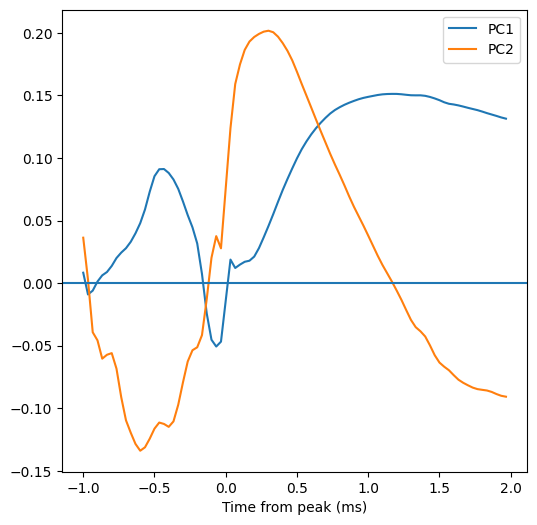

In [40]:
fig = plt.figure(figsize=(6, 6))
time_drop = np.delete(pc_time, 30)  # remove the peak sample to avoid bias in PCA
plt.plot(time_drop, pca.components_[0], label = 'PC1')
plt.plot(time_drop, pca.components_[1], label = 'PC2')
plt.axhline(0)
plt.legend()
plt.xlabel('Time from peak (ms)')

In [41]:
# save waveform features
score = np.full(len(all_wfs_nl), np.nan)
score[~np.isnan(all_wfs_nl[:,0])] = np.dot(focus_pcs, direction)
pc1_all = np.full(len(all_wfs_nl), np.nan)
pc1_all[~np.isnan(all_wfs_nl[:,0])] = pca_result[:, 0]
pc2_all = np.full(len(all_wfs_nl), np.nan)
pc2_all[~np.isnan(all_wfs_nl[:,0])] = pca_result[:, 1]

wf_features['score'] = score
wf_features['pc1'] = pc1_all
wf_features['pc2'] = pc2_all
wf_features['wf'] = all_wfs_nl.tolist()
wf_features['cluster'] = clusters
# save to pickle 
with open(os.path.join(wf_folder, 'wf_features.pkl'), 'wb') as f:
    pickle.dump(wf_features, f)

In [42]:
# features = wf_features.columns.tolist()
# features.remove('probe')
# features.remove('session')
# features.remove('unit_id')
# ncols = len(features)
# sessions = combined_tagged_units_filtered['session'].unique()
# for session in sessions:
#     session_combined_tagged_units_filtered = combined_tagged_units_filtered[combined_tagged_units_filtered['session'] == session].reset_index(drop=True)
#     session_wf_features = wf_features[combined_tagged_units_filtered['session'] == session].reset_index(drop=True)
#     if len(session_combined_tagged_units_filtered) < 5:
#         print('Not enough units for session:', session)
#         continue
#     fig_feature, axes_f = plt.subplots(1, ncols=ncols, figsize=(20, 5))
#     x = np.random.rand(len(session_combined_tagged_units_filtered))
#     for f_ind, feature in enumerate(features):
#         if feature not in wf_features.columns:
#             continue
#         # scatter plot by y_loc, color coded by feature, with color bar
#         focus = session_wf_features[feature].values
#         # random number for x
#         axes_f[f_ind].scatter(x, session_wf_features['y_loc'], c=focus, cmap='Reds', s=40, edgecolor='black', alpha=0.5)
#         axes_f[f_ind].set_xlabel(feature)
#         if f_ind == 0:
#             axes_f[f_ind].set_ylabel('y_loc')
#         else:
#             axes_f[f_ind].yaxis.set_ticks([])
#         axes_f[f_ind].set_xlim(np.min(x)-0.2, np.max(x)+0.2)
#         # turn off axis
#         # for spine in ['top', 'bottom', 'left', 'right']:
#         #     axes_f[f_ind].spines[spine].set_visible(False)
#         # turn off x axis ticks
#         axes_f[f_ind].xaxis.set_ticks([])

#     title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
#     plt.suptitle(session+title, fontsize=16)
#     plt.tight_layout()
#     plt.savefig(fname=os.path.join(wf_folder, f'{session}_all_feature_{criteria_name}.png'), dpi=300, bbox_inches='tight')

#     # reordered = session_combined_tagged_units_filtered.sort_values(by='y_loc', ascending=False).reset_index(drop=True)
#     # fig_wf, axe_wf = plt.subplots(nrows=len(reordered), ncols=1, figsize=(5, 2*len(reordered)))
#     # for i, row in reordered.iterrows():
#     #     wf = row['wf']
#     #     peak = row['peak']
#     #     axe_wf[i].plot(wf/np.abs(peak), color='blue')
#     #     axe_wf[i].set_title(f'{row["y_loc"]}')
#     #     axe_wf[i].axis('off')      
#     # fig_wf.tight_layout()
#     # fig_wf.savefig(fname=os.path.join('/root/capsule/scratch/combined/wf_plots', f'{session}_wf.png'), dpi=300, bbox_inches='tight')

In [43]:
# g = sns.pairplot(wf_features, corner=False, 
#              plot_kws={'alpha': 0.5, 's': 10},
#             #  hue='probe'
#              )
# # save figure
# # title = f"{len(wf_features)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak_raw']['bounds'][1]} uV"
# g.fig.suptitle(title, y=1.02)
# g.savefig(os.path.join(wf_folder, f'Wf_features_pairplot_{criteria_name}_all.png'), dpi=300)

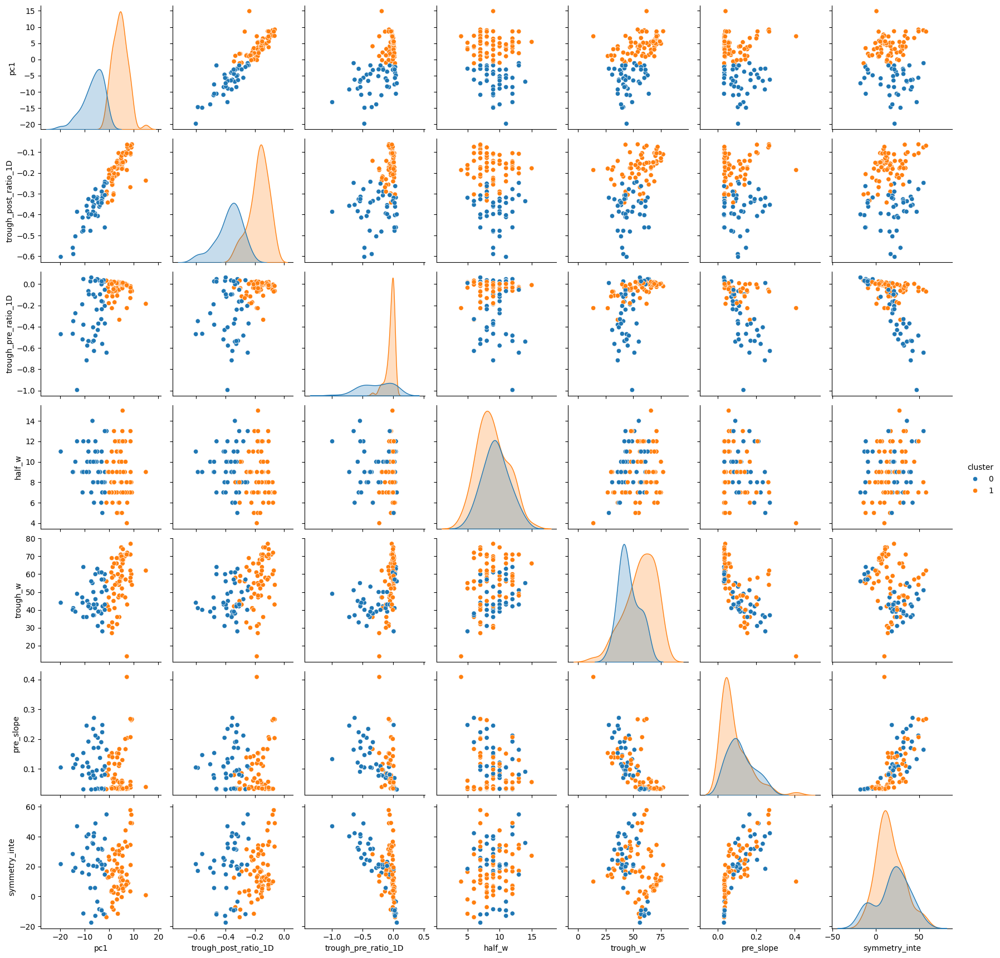

In [44]:
feature = wf_features[['pc1', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope', 'cluster', 'symmetry_inte']].copy()
g = sns.pairplot(feature, corner=False, hue = 'cluster')

In [68]:
feature = wf_features[['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope', 'cluster', 'pre_space']].copy()
# g = sns.pairplot(feature, corner=False)

<Figure size 800x600 with 0 Axes>

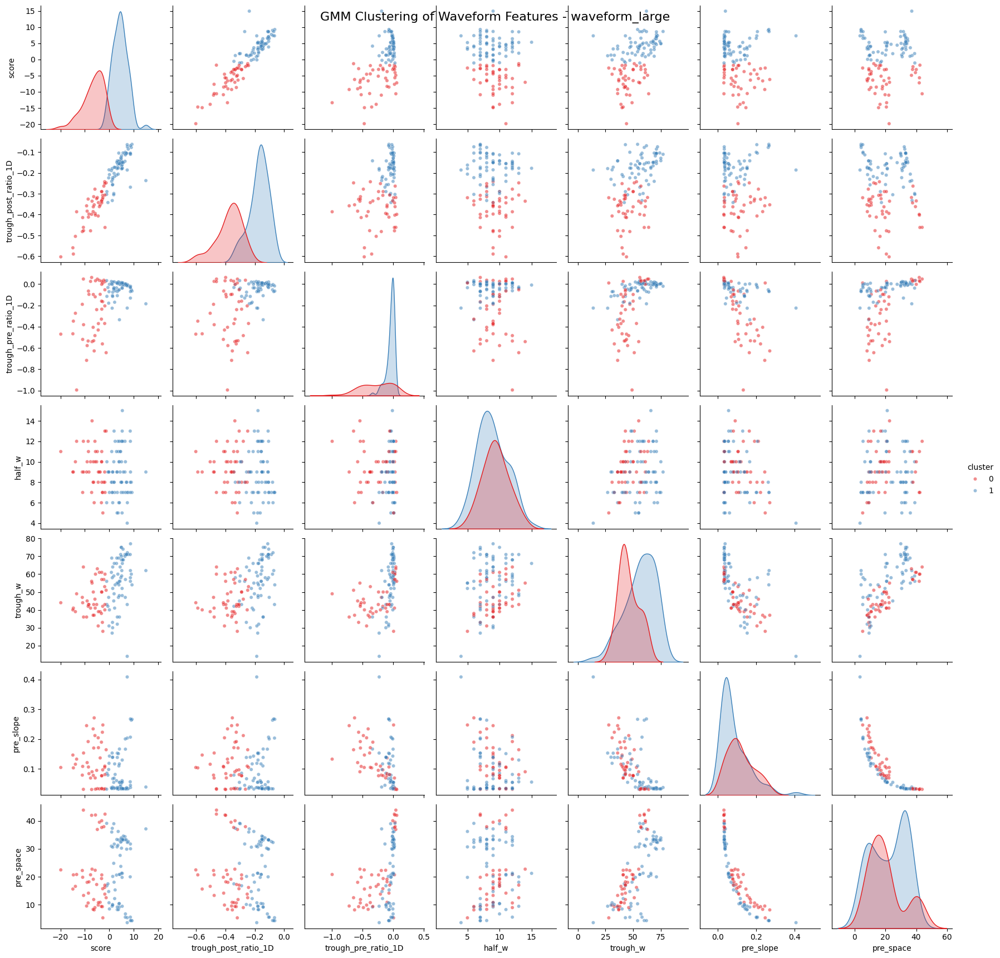

In [69]:
# perform GMM clustering using features from wf_features
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=2, random_state=1)
feature_list = ['trough_w', 'pre_space']
zscore_feature = zscore(feature[feature_list], axis=0, nan_policy='omit')
gmm.fit(zscore_feature)
feature['gmm_label'] = gmm.predict(zscore_feature)
# plot the GMM clusters
plt.figure(figsize=(8, 6))
g = sns.pairplot(data=feature, hue='cluster', vars=['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope', 'pre_space'], palette='Set1', plot_kws={'alpha': 0.5, 's': 20})
plt.xlabel('Score')
plt.ylabel('Trough Post Ratio')
plt.suptitle(f'GMM Clustering of Waveform Features - {criteria_name}', fontsize=16)
# save the GMM model
plt.savefig(os.path.join(wf_folder, f'GMM_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')
# save feature with gmm cluestering applied
wf_features['gmm_label'] = feature['gmm_label']
wf_features['gmm_conf'] = np.max(gmm.predict_proba(zscore_feature), axis = 1)
wf_features.to_csv(os.path.join(wf_folder, 'wf_features.csv'), index=False)


<Figure size 800x600 with 0 Axes>

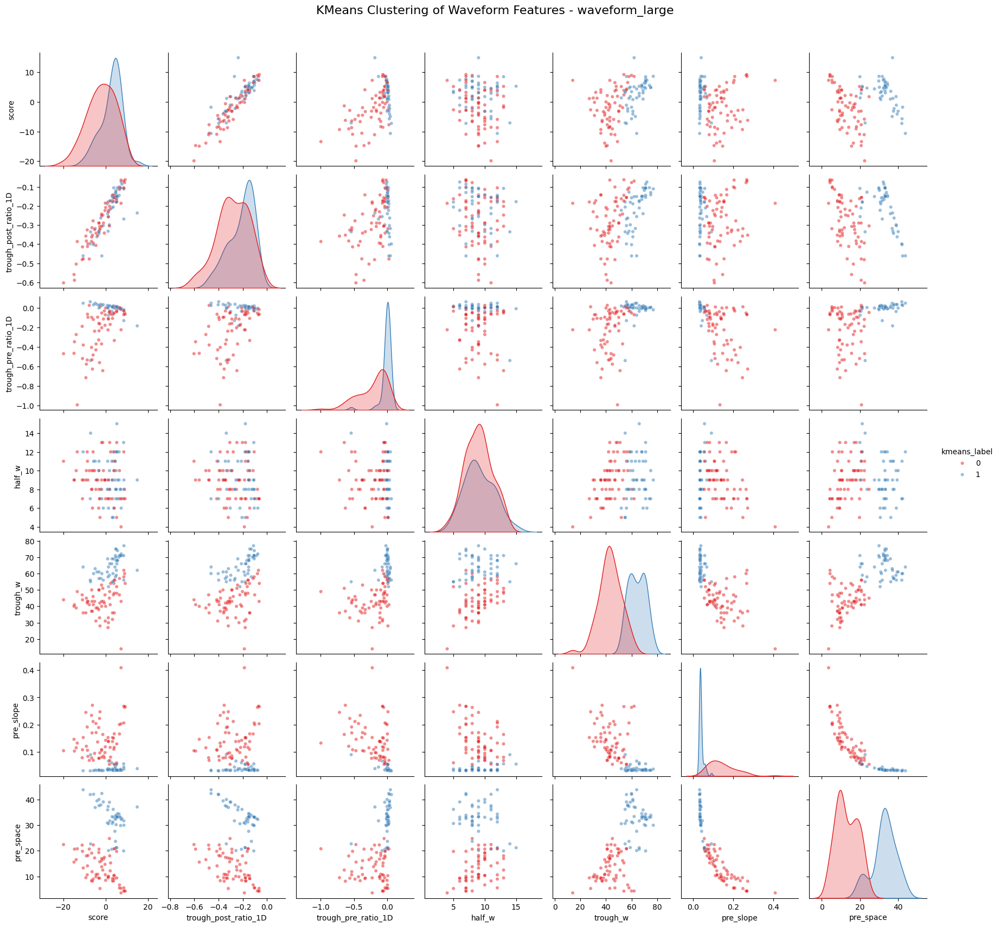

In [71]:
from sklearn.cluster import KMeans

# Perform KMeans clustering using features from wf_features
kmeans = KMeans(n_clusters=2, random_state=4, n_init='auto')  # Adjust n_init for sklearn >= 1.2
feature_list = ['trough_w', 'pre_space']
zscore_feature = zscore(feature[feature_list], axis=0, nan_policy='omit')

# Fit KMeans and assign cluster labels
kmeans.fit(zscore_feature)
feature['kmeans_label'] = kmeans.labels_

# Plot the KMeans clusters
plt.figure(figsize=(8, 6))
g = sns.pairplot(
    data=feature,
    hue='kmeans_label',
    vars=['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope', 'pre_space'],
    palette='Set1',
    plot_kws={'alpha': 0.5, 's': 20}
)

# Add title and save plots
plt.suptitle(f'KMeans Clustering of Waveform Features - {criteria_name}', fontsize=16)
g.fig.subplots_adjust(top=0.93)  # Adjust to make room for title

g.savefig(os.path.join(wf_folder, f'KMeans_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

# Save features with KMeans clustering applied
wf_features['kmeans_label'] = feature['kmeans_label']
wf_features.to_csv(os.path.join(wf_folder, 'wf_features.csv'), index=False)


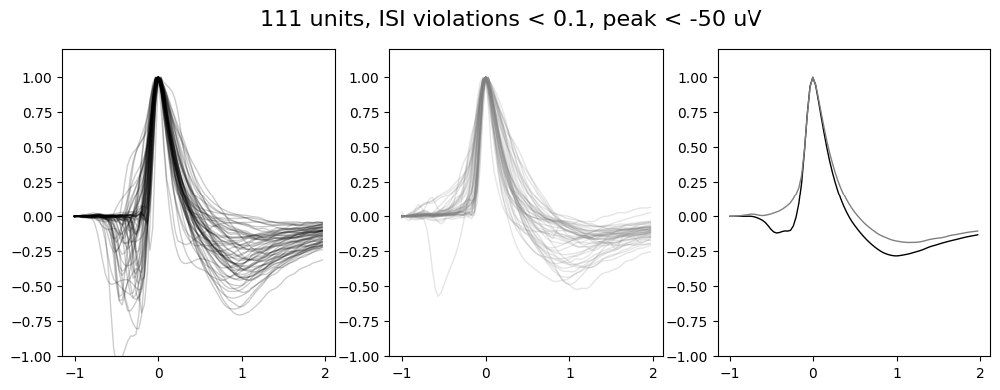

In [72]:
fig = plt.figure(figsize=(12, 4))
wf_time = (np.arange(90) - 30)/30000 * 1000  # assuming 90 samples in the waveform
filter = feature['kmeans_label'] == 0  # filter for the first cluster
plt.subplot(1, 3, 1)
plt.ylim(-1, 1.2)
plt.plot(wf_time, all_wfs_nl[filter].T, alpha=0.2, linewidth=1, color='k');
plt.subplot(1, 3, 2)
plt.plot(wf_time, all_wfs_nl[~filter].T, alpha=0.2, linewidth=1, color=[0.5, 0.5, 0.5]);  # plot the ones with higher pca values in black
plt.ylim(-1, 1.2)
plt.subplot(1, 3, 3)
plt.ylim(-1, 1.2)
plt.plot(wf_time, np.mean(all_wfs_nl[filter], axis=0), linewidth=1, color='k');  # plot the ones with higher pca values in black
plt.plot(wf_time, np.mean(all_wfs_nl[~filter], axis=0), linewidth=1, color=[0.5, 0.5, 0.5]);
# title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.suptitle(title, fontsize=16)
plt.savefig(fname=os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

if 'anti_resp' in combined_tagged_units_filtered.columns:
    plt.subplot(1, 3, 1)
    plt.plot(wf_time, all_wfs_nl[filter & (combined_tagged_units_filtered['anti_resp'] <= 2) & (wf_features['gmm_conf']>0.9)].T, alpha=0.8, linewidth=1, color='r');
    plt.ylim(-1, 1.2)
    plt.subplot(1, 3, 2)
    plt.plot(wf_time, all_wfs_nl[~filter & (combined_tagged_units_filtered['anti_resp'] <= 2) & (wf_features['gmm_conf']>0.9)].T, alpha=0.8, linewidth=1, color='r');  # plot the ones with higher pca values in black
    plt.ylim(-1, 1.2)
plt.savefig(fname=os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [89]:
x_feature = 'trough_w'
y_feature = 'pre_space'
plt.figure(figsize=(8, 6))
colors =  [[0, 0, 0], [0.4, 0.4, 0.4]]
for i, label in enumerate(feature['cluster'].unique()):
    subset = feature[feature['cluster'] == label]
    plt.scatter(subset[x_feature], subset[y_feature], facecolors='none', label=f'Cluster {label}', edgecolors = colors[label], s = 45, linewidths=2)
if 'anti_resp' in combined_tagged_units_filtered.columns:
    subset = feature[combined_tagged_units_filtered['anti_resp'] == 1]
    plt.scatter(subset[x_feature], subset[y_feature], facecolors='red', edgecolors='none', s=30, linewidths=2, label='Anti-responsive')
plt.xlabel(x_feature)
plt.ylabel(y_feature)
plt.legend()
plt.savefig(os.path.join(wf_folder, f'{x_feature}_{y_feature}_gmm_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

TypeError: string indices must be integers

<Figure size 800x600 with 0 Axes>

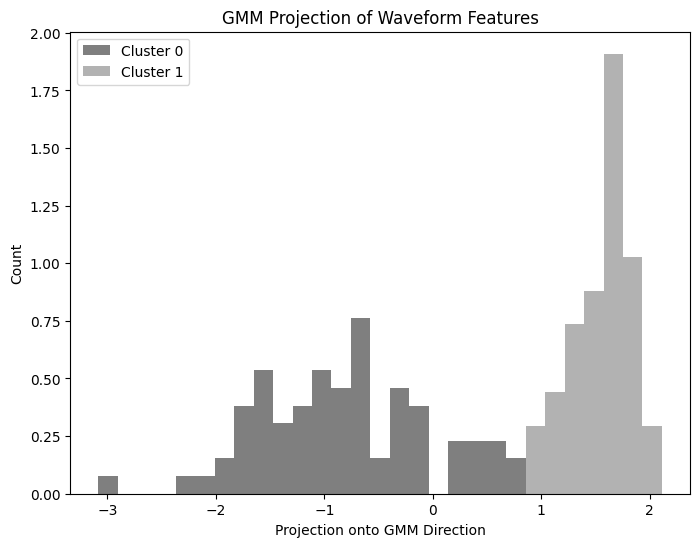

In [79]:
# Compute projection direction: vector between the two GMM means
mean_diff = gmm.means_[1] - gmm.means_[0]
projection_direction = mean_diff / np.linalg.norm(mean_diff)  # Normalize

# Project all points onto that direction
# projected_values = feature['score']
projected_values = np.dot(zscore_feature, projection_direction)
feature['gmm_projection'] = projected_values

# Plot the projection
plt.figure(figsize=(8, 6))
bins = np.linspace(np.min(projected_values), np.max(projected_values), 30)
plt.hist(projected_values[feature['gmm_label'] == 0], bins=bins, color=colors[0], alpha=0.5, label='Cluster 0', density=True)
plt.hist(projected_values[feature['gmm_label'] == 1], bins=bins, color= colors[1], alpha=0.5, label='Cluster 1', density=True)
plt.xlabel('Projection onto GMM Direction')
plt.ylabel('Count')
plt.title('GMM Projection of Waveform Features')

# scatter the anti-responsive units
if 'anti_resp' in combined_tagged_units_filtered.columns:
    anti_resp = feature[(combined_tagged_units_filtered['anti_resp'] <=2) & (wf_features['gmm_conf']>0.9)]
    plt.scatter(anti_resp['gmm_projection'], np.zeros_like(anti_resp['gmm_projection'])+13, color='red', label='Anti-responsive', s=30, edgecolors='none')

plt.legend()
plt.savefig(os.path.join(wf_folder, f'GMM_projection_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


# Compare hp vs raw waveforms

In [51]:
# wf_folder_raw_csv = os.path.join('/root/capsule/scratch/combined/wf_plots', criteria_name, '_raw', 'wf_features.pkl')
# wf_folder_hp_csv = os.path.join('/root/capsule/scratch/combined/wf_plots', criteria_name, '', 'wf_features.pkl')
# with open(wf_folder_raw_csv, 'rb') as f:
#     wf_features_raw = pickle.load(f)
# with open(wf_folder_hp_csv, 'rb') as f:
#     wf_features_hp = pickle.load(f)
# clusters = wf_features_raw['cluster']

In [52]:
# len(wf_features_raw), len(wf_features_hp)

In [53]:
# # compare features:
# cluster_colors = ['k', 'gray']
# feature_list = wf_features_raw.columns.tolist()
# fig = plt.figure(figsize=(16,4*len(feature_list)/4))
# gs = gridspec.GridSpec(int(np.ceil(len(feature_list)/4)), 4, figure=fig)
# for i, feature in enumerate(feature_list):
#     if feature not in wf_features_hp.columns or pd.api.types.is_complex(wf_features_hp[feature]):
#         continue
#     # skip if array
#     if isinstance(wf_features_hp[feature].values[0], (list, str)):
#         continue

#     ax = fig.add_subplot(gs[i])
#     for cluster_id in range(2):
#         ax.scatter(wf_features_raw[feature][clusters==cluster_id], wf_features_hp[feature][clusters==cluster_id], alpha=0.7, s=30, edgecolors='none', color=cluster_colors[cluster_id], label=f'Cluster {cluster_id}')

#     ax.plot([wf_features_raw[feature].min(), wf_features_raw[feature].max()],
#                 [wf_features_raw[feature].min(), wf_features_raw[feature].max()], 
#                 color='red', linestyle='--', linewidth=1)
#     ax.legend()
#     ax.set_xlabel('Raw')
#     ax.set_ylabel('HP')
#     ax.set_title(feature)
# plt.tight_layout()
# plt.suptitle(f'Comparison of Waveform Features raw vs hp - {criteria_name}', fontsize=16, y=1.02)
# plt.savefig(os.path.join('/root/capsule/scratch/combined/wf_plots', criteria_name, f'Feature_comparison_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

# PCA on pre and post peak

In [81]:
# pre and post peak pca
default_peak_ind = 30
pre_post_cut = 9
wf_mat_pre = all_wfs_nl[:, :default_peak_ind]
wf_mat_post = all_wfs_nl[:, default_peak_ind+pre_post_cut:]
wf_mat_pre = zscore(wf_mat_pre, axis=0)  # z-score normalize the waveforms
wf_mat_post = zscore(wf_mat_post, axis=0)  # z-score normalize the waveforms
# remove the columns with all values as nan
pre_nan_ind = np.all(np.isnan(wf_mat_pre), axis=0)
wf_mat_pre = wf_mat_pre[:, ~pre_nan_ind]

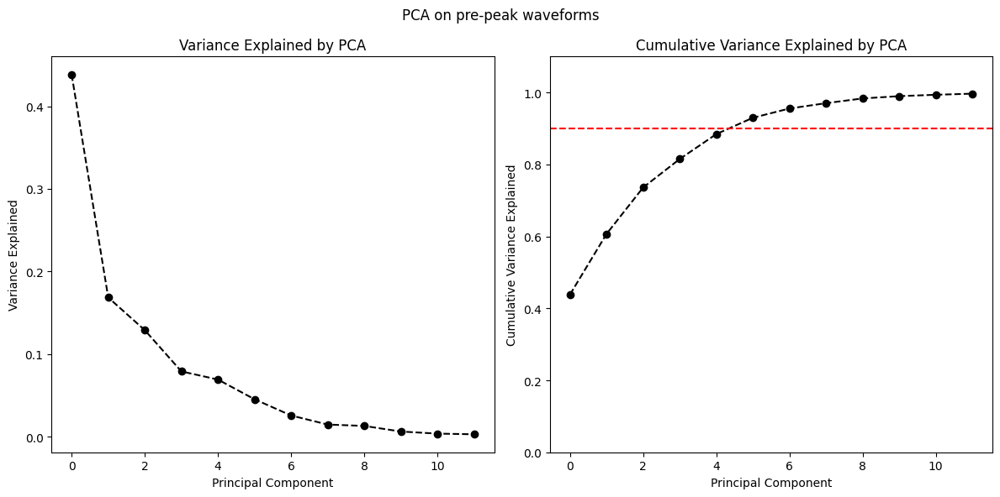

In [82]:
pca_pre = PCA(n_components=12)  # we can choose the number of components we want
pca_result_pre = pca_pre.fit_transform(wf_mat_pre)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
axes[0].plot(pca_pre.explained_variance_ratio_, marker='o', linestyle='--', color='black')
axes[0].set_xlabel('Principal Component')
axes[0].set_ylabel('Variance Explained')
axes[0].set_title('Variance Explained by PCA')
axes[1].plot(np.cumsum(pca_pre.explained_variance_ratio_), marker='o', linestyle='--', color='black')
axes[1].axhline(0.9, color='red', linestyle='--', label='90% Variance')
axes[1].set_ylim(0, 1.1)
axes[1].set_xlabel('Principal Component')
axes[1].set_ylabel('Cumulative Variance Explained')
axes[1].set_title('Cumulative Variance Explained by PCA')
plt.suptitle('PCA on pre-peak waveforms')
plt.tight_layout()


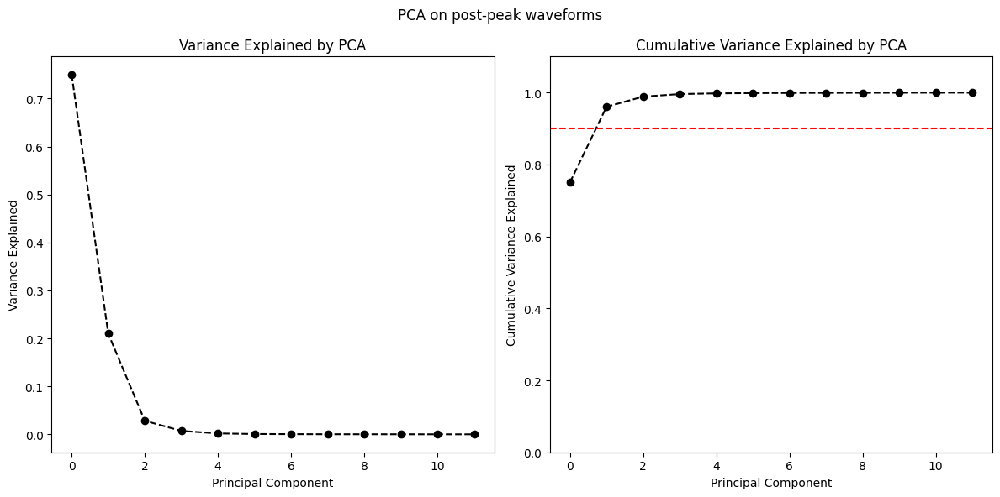

In [83]:
pca_post = PCA(n_components=12)  # we can choose the number of components we want
pca_result_post = pca_post.fit_transform(wf_mat_post)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
axes[0].plot(pca_post.explained_variance_ratio_, marker='o', linestyle='--', color='black')
axes[0].set_xlabel('Principal Component')
axes[0].set_ylabel('Variance Explained')
axes[0].set_title('Variance Explained by PCA')
axes[1].plot(np.cumsum(pca_post.explained_variance_ratio_), marker='o', linestyle='--', color='black')
axes[1].axhline(0.9, color='red', linestyle='--', label='90% Variance')
axes[1].set_ylim(0, 1.1)
axes[1].set_xlabel('Principal Component')
axes[1].set_ylabel('Cumulative Variance Explained')
axes[1].set_title('Cumulative Variance Explained by PCA')
plt.suptitle('PCA on post-peak waveforms')
plt.tight_layout()

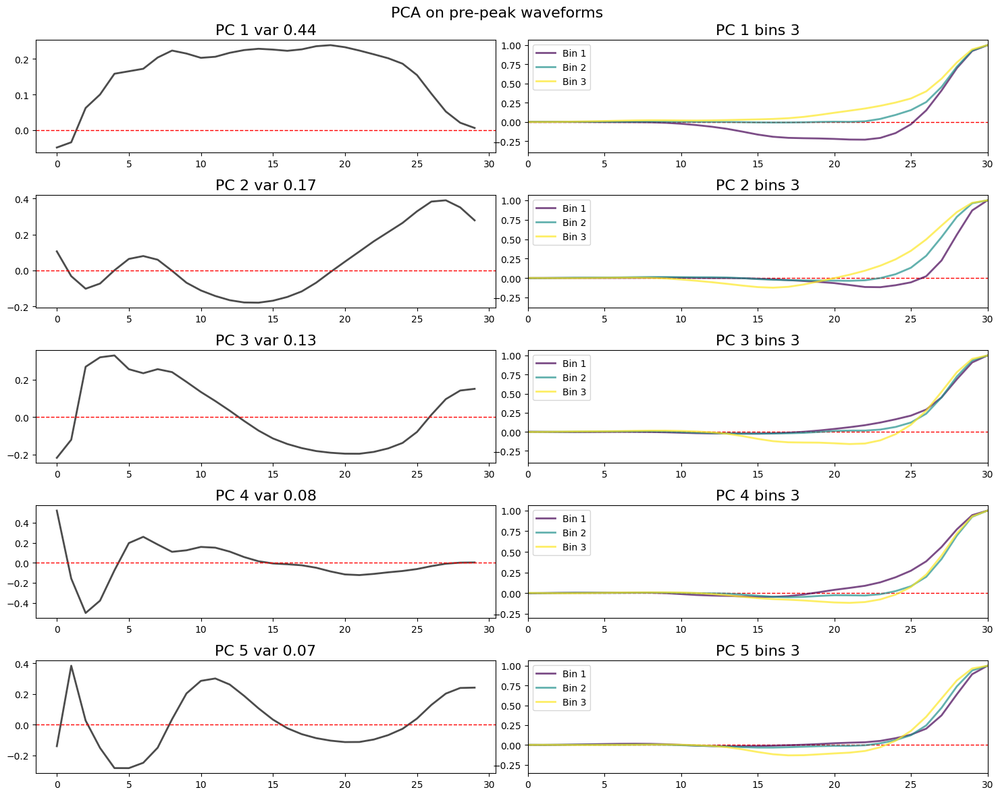

In [84]:
bin_num = 3
pc_num = 5
gs = gridspec.GridSpec(pc_num, 2, figure=plt.figure(figsize=(3*pc_num, 3*(bin_num+1))))
colors = plt.cm.viridis(np.linspace(0, 1, bin_num))
for pc_ind in range(pc_num):
    curr_pc = pca_pre.components_[pc_ind, :] 
    curr_pc = np.insert(curr_pc, np.where(pre_nan_ind)[0], np.nan) 
    ax = plt.subplot(gs[pc_ind, 0])
    ax.plot(curr_pc, color='k', linewidth=2, alpha=0.7)
    # im = ax.imshow(curr_pc, aspect='auto', cmap='bwr', vmin=-np.nanmax(np.abs(curr_pc)), vmax=np.nanmax(np.abs(curr_pc)))
    # plt.colorbar(im, ax=ax)
    ax.set_title(f'PC {pc_ind+1} var {pca_pre.explained_variance_ratio_[pc_ind]:.2f}', fontsize=16)
    ax.axhline(0, color='red', linestyle='--', linewidth=1)

    pca_result_curr = pca_result_pre[:, pc_ind]
    edges = np.linspace(np.nanmin(pca_result_curr), np.nanmax(pca_result_curr), bin_num+1)
    edges = np.quantile(pca_result_curr, np.linspace(0, 1, bin_num+1))  # use quantiles to create bins
    edges[0] = edges[0]-0.001
    edges[-1] = edges[-1]+0.001
    ax = plt.subplot(gs[pc_ind, 1])
    ax.axhline(0, color='red', linestyle='--', linewidth=1)
    # edges = np.quantile(pca_result_curr, np.linspace(0, 1, bin_num+1))  # use quantiles to create bins
    for bin_ind in range(bin_num):
        mask = (pca_result_curr >= edges[bin_ind]) & (pca_result_curr < edges[bin_ind+1])
        wf_bin = all_wfs_nl_clean[mask]
        if len(wf_bin) == 0:
            continue
        wf_bin = np.nanmean(wf_bin, axis=0)
        ax.plot(wf_bin, color=colors[bin_ind], linewidth=2, alpha=0.7, label=f'Bin {bin_ind+1}')
    ax.legend()
    ax.set_xlim([0, default_peak_ind])
    ax.set_title(f'PC {pc_ind+1} bins {bin_num}', fontsize=16)

plt.suptitle('PCA on pre-peak waveforms', fontsize=16)
plt.tight_layout()



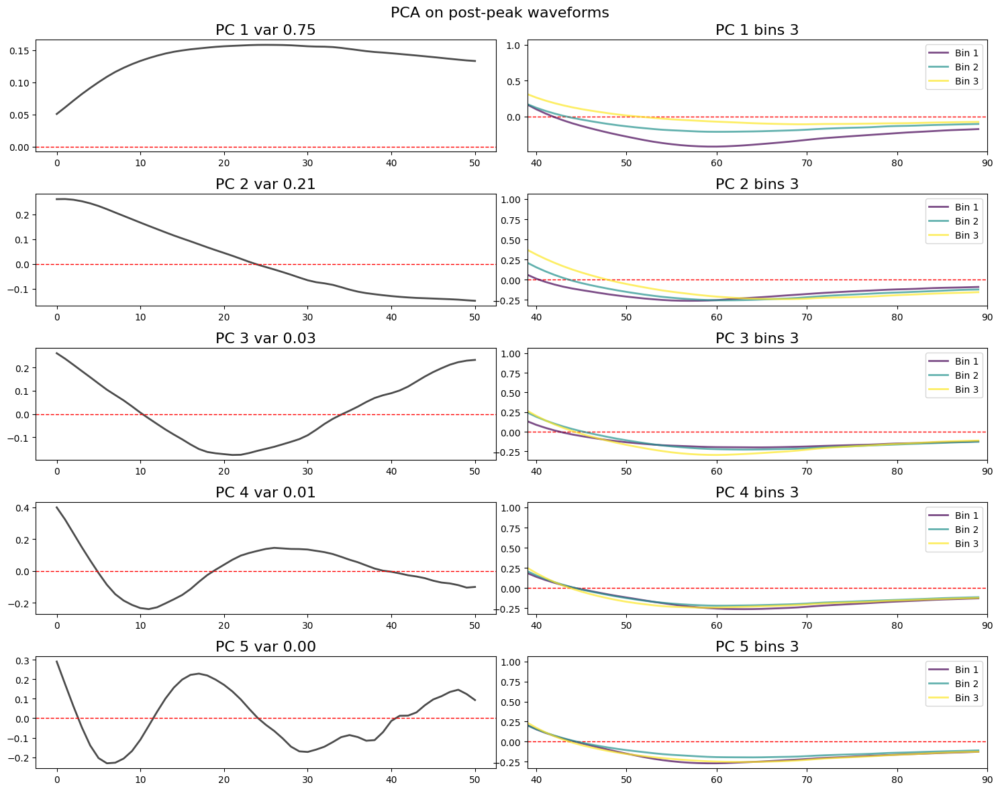

In [85]:
bin_num = 3
pc_num = 5
gs = gridspec.GridSpec(pc_num, 2, figure=plt.figure(figsize=(3*pc_num, 3*(bin_num+1))))
colors = plt.cm.viridis(np.linspace(0, 1, bin_num))
for pc_ind in range(pc_num):
    curr_pc = pca_post.components_[pc_ind, :] 
    ax = plt.subplot(gs[pc_ind, 0])
    ax.plot(curr_pc, color='k', linewidth=2, alpha=0.7)
    # im = ax.imshow(curr_pc, aspect='auto', cmap='bwr', vmin=-np.nanmax(np.abs(curr_pc)), vmax=np.nanmax(np.abs(curr_pc)))
    # plt.colorbar(im, ax=ax)
    ax.set_title(f'PC {pc_ind+1} var {pca_post.explained_variance_ratio_[pc_ind]:.2f}', fontsize=16)
    ax.axhline(0, color='red', linestyle='--', linewidth=1)

    pca_result_curr = pca_result_post[:, pc_ind]
    edges = np.linspace(np.nanmin(pca_result_curr), np.nanmax(pca_result_curr), bin_num+1)
    edges = np.quantile(pca_result_curr, np.linspace(0, 1, bin_num+1))  # use quantiles to create bins
    edges[0] = edges[0]-0.001
    edges[-1] = edges[-1]+0.001
    ax = plt.subplot(gs[pc_ind, 1])
    ax.axhline(0, color='red', linestyle='--', linewidth=1)
    # edges = np.quantile(pca_result_curr, np.linspace(0, 1, bin_num+1))  # use quantiles to create bins
    for bin_ind in range(bin_num):
        mask = (pca_result_curr >= edges[bin_ind]) & (pca_result_curr < edges[bin_ind+1])
        wf_bin = all_wfs_nl_clean[mask]
        if len(wf_bin) == 0:
            continue
        wf_bin = np.nanmean(wf_bin, axis=0)
        ax.plot(wf_bin, color=colors[bin_ind], linewidth=2, alpha=0.7, label=f'Bin {bin_ind+1}')
    ax.legend()
    ax.set_xlim([default_peak_ind+pre_post_cut, 90])
    ax.set_title(f'PC {pc_ind+1} bins {bin_num}', fontsize=16)

plt.suptitle('PCA on post-peak waveforms', fontsize=16)
plt.tight_layout()




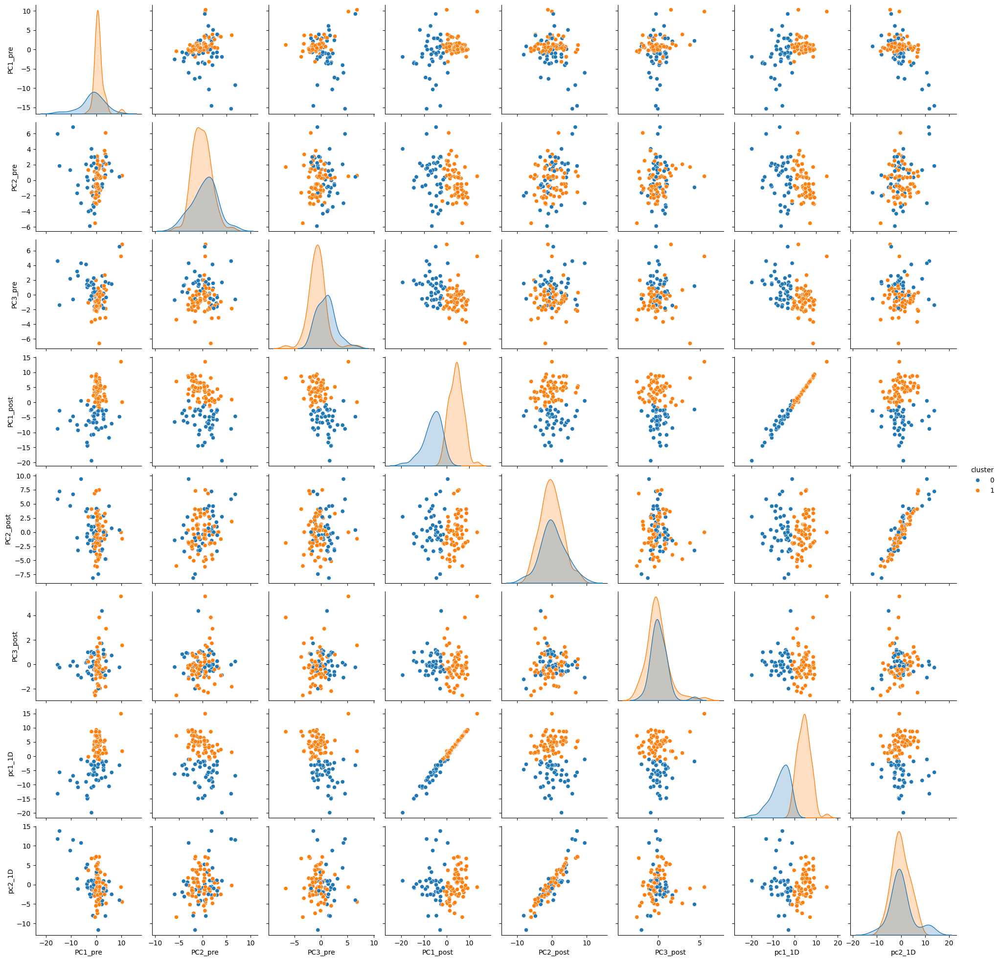

In [86]:
# plot all pcs from pre and post waveform pca against each other
pc_list = range(3)
conditions = ['pre', 'post']
pre_pcs = pca_result_pre[:, pc_list]
post_pcs = pca_result_post[:, pc_list]
# combine into a dataframe
pre_pcs = pd.DataFrame(pre_pcs, columns=[f'PC{i+1}_pre' for i in pc_list])
post_pcs = pd.DataFrame(post_pcs, columns=[f'PC{i+1}_post' for i in pc_list])
wf_pcs_combined = pd.concat([pre_pcs, post_pcs], axis=1)
wf_features = pd.concat([wf_features, wf_pcs_combined], axis=1)
wf_pcs_combined['pc1_1D'] = wf_features['pc1'].values  # add the pc1 feature 
wf_pcs_combined['pc2_1D'] = wf_features['pc2'].values  # add the pc2 feature
wf_pcs_combined['cluster'] = wf_features['cluster'].values  # add the cluster feature
# plot the pcs against each other
sns.pairplot(wf_pcs_combined,
            #  corner=True,
            #  hue = 'pc1_1D',
             hue = 'cluster',
            #  diag_kws={'bins': 30},
             )

# Plot in space

In [87]:
features = wf_features.columns.tolist()
for col in ['unit_id', 'session', 'probe', 'wf', 'amp', 'peak']:
    if col in features:
        features.remove(col)

half_w
trough_w
pre_half
post_half
post_w
trough_post_ratio_1D
trough_pre_ratio_1D
post_slope
post_space
pre_slope
pre_space
symmetry_inte
symmetry_half
symmetry_slope
symmetry_inte_div
symmetry_half_div
symmetry_slope_div
y_loc
score
pc1
pc2
cluster
gmm_label
gmm_conf
kmeans_label


PC1_pre


ValueError: The 'color' keyword argument must have one color per dataset, but 2 datasets and 1 colors were provided

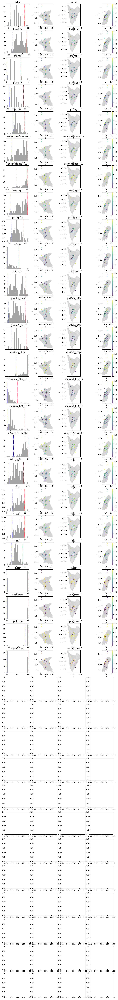

In [88]:
from matplotlib.colors import Normalize
norm = Normalize(vmin=0, vmax=1)

mesh = load_mesh('/root/capsule/scratch/combined/ccf_maps/20250418_transformed_remesh_10_ccf25.obj')
mesh_vertices = np.array(mesh.vertices)
mesh_vertices_mm = ccf_pts_convert_to_mm(mesh_vertices)
mesh_vertices_mm[:, 2] = -np.abs(mesh_vertices_mm[:, 2])  # Mirror ML to left
blue_white_red = LinearSegmentedColormap.from_list(
    'blue_white_red',
    [(0, 'blue'), (0.5, 'white'), (1.0, 'red')]
)
ml, ap, dv = 2, 0, 1
planes = {'sag': [ap, dv], 'hor': [ml, ap], 'cor': [ml, dv]}

fig, axes = plt.subplots(len(features), 4, figsize=(12, 3*len(features)))

for ind, feature in enumerate(features):
    ax = axes[ind, 0]
    color_code = wf_features[feature].values
    print(feature)
    ax.hist(color_code, bins=30, color='gray', alpha=0.7)
    ax.set_title(feature)
    top_90 = np.quantile(color_code, 0.95)
    bottom_10 = np.quantile(color_code, 0.05)
    ax.axvline(top_90, color='red', linestyle='--', linewidth=1)
    ax.axvline(bottom_10, color='blue', linestyle='--', linewidth=1)
    color_code_nl = color_code.copy()
    color_code_nl[color_code > top_90] = top_90
    color_code_nl[color_code < bottom_10] = bottom_10
    color_code_nl = (color_code_nl - bottom_10) / (top_90 - bottom_10)  # Normalize color code to [0, 1] using 10-90% quantiles
    x_ccf = combined_tagged_units_filtered['x_ccf'].values
    y_ccf = combined_tagged_units_filtered['y_ccf'].values
    z_ccf = combined_tagged_units_filtered['z_ccf'].values
    ccfs = np.column_stack((x_ccf, y_ccf, z_ccf))
    ccfs = ccf_pts_convert_to_mm(ccfs)
    ccfs[:, 2] = -np.abs(ccfs[:, 2])  # Mirror ML to left
    for plane, ax in zip(planes.keys(), axes[ind, 1:]):
        # Plot the mesh
        ax.scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
        # Plot the points
        sc = ax.scatter(ccfs[:, planes[plane][0]], ccfs[:, planes[plane][1]], c=color_code_nl, cmap='viridis', s=10, edgecolor='none', alpha=0.7)
        if plane == 'hor':
            ax.set_title(feature)
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        # set equal aspect ratio
        ax.set_aspect('equal')
        if planes[plane][1] == dv:
            ax.invert_yaxis()
        if plane == 'cor':
            fig.colorbar(sc, ax=ax, orientation='vertical', fraction=0.05)

plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'PCA_pre_post_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
features = wf_features.columns.tolist()
for col in ['unit_id', 'session', 'probe', 'wf', 'amp', 'peak']:
    if col in features:
        features.remove(col)
g = sns.pairplot(wf_features[features], hue='cluster')

# Loop over axes to explicitly set x and y axis labels
features_label = features.copy()
features_label.remove('cluster')
for i, row in enumerate(g.axes):
    for j, ax in enumerate(row):
        if ax is not None:
            ax.set_xlabel(features_label[j])
            ax.xaxis.label.set_visible(True)
            ax.set_ylabel(features_label[i])
            ax.yaxis.label.set_visible(True)

plt.tight_layout()

# Save the pairplot
g.fig.suptitle(f'Pairplot of Waveform Features - {criteria_name}', fontsize=16, y=1.02)
g.fig.savefig(os.path.join(wf_folder, f'Pairplot_wf_features_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
with open(os.path.join(wf_folder, 'wf_features_combined.pkl'), 'wb') as f:
    pickle.dump(wf_features, f)

In [ ]:
# # load the saved features
# with open(os.path.join(wf_folder, 'wf_features.pkl'), 'rb') as f:
#     wf_features = pickle.load(f)

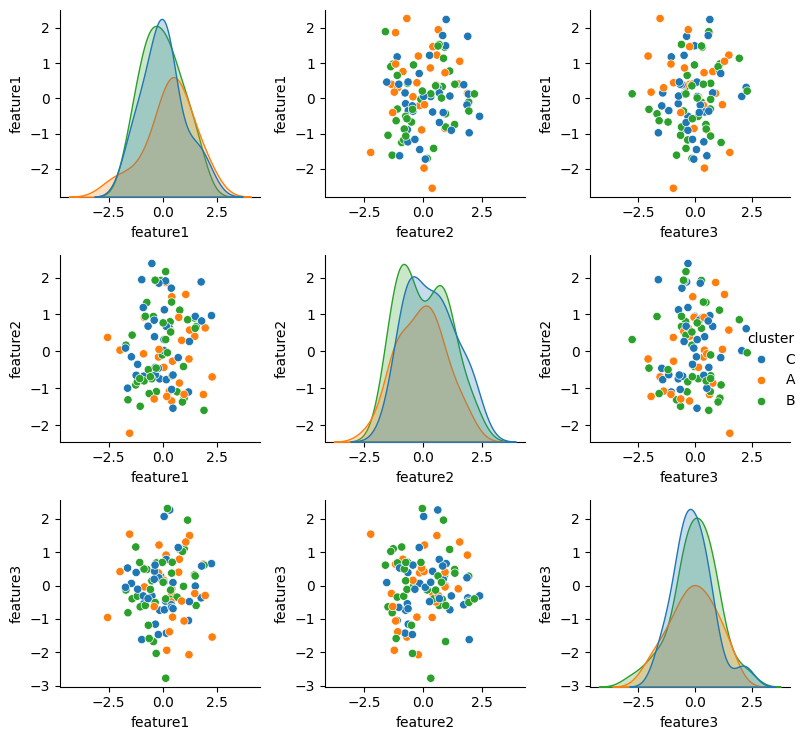

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Example DataFrame
np.random.seed(0)
wf_features = pd.DataFrame({
    'feature1': np.random.randn(100),
    'feature2': np.random.randn(100),
    'feature3': np.random.randn(100),
    'cluster': np.random.choice(['A', 'B', 'C'], 100)
})

features = ['feature1', 'feature2', 'feature3']

g = sns.pairplot(wf_features, vars=features, hue='cluster')

for i, row in enumerate(g.axes):
    for j, ax in enumerate(row):
        if ax is not None:
            # Set X label and force it visible
            ax.set_xlabel(features[j])
            ax.xaxis.label.set_visible(True)
            
            # Set Y label and force it visible
            ax.set_ylabel(features[i])
            ax.yaxis.label.set_visible(True)
            
            # Ensure tick labels are visible too (optional)
            ax.tick_params(labelbottom=True, labelleft=True)

plt.tight_layout()




In [ ]:


# # -----------------------
# # Generate synthetic data
# # -----------------------
# np.random.seed(40)
# n_samples = 100
# n = n_samples
# n_regressors = 10

# # True projection direction (unit vector)
# v_true = np.random.randn(3)
# v_true /= np.linalg.norm(v_true)

# # True regressor weights
# w_true = np.random.randn(n_regressors)

# # Data
# X = np.random.randn(n_samples, n_regressors)
# y = X @ w_true + 0.1 * np.random.randn(n_samples)  # observed projection

# # Step 1: Basis for orthogonal space (null space of v_trueᵗ)
# null_basis = null_space(v_true[None, :])  # shape (3, 2)

# # Step 2: Random offsets in orthogonal space
# rand_coeffs = np.random.randn(n, 2)
# orthogonal_offsets = rand_coeffs @ null_basis.T  # shape (n, 3)

# # Step 3: True projected component
# P_proj = np.outer(y, v_true)  # shape (n, 3)

# # Step 4: Final spatial positions
# P = P_proj + orthogonal_offsets


In [ ]:

# -----------------------
# Optimization target
# -----------------------

def loss_fn(params, P, X, lambda_reg=0):
    v = params[:np.shape(P)[1]]
    w = params[np.shape(P)[1]:]
    proj = P @ v
    pred = X @ w # n unit x p feature @ p feature x 1
    reg_term = lambda_reg * np.mean(np.abs(w))
    cost = -np.corrcoef(proj, pred)[0, 1]
    # cost = np.mean((proj - pred) ** 2)/np.std(proj)

    return cost + reg_term


def loss_fn_fix_v(params, y, X, lambda_reg=0.1):
    pred = X @ params
    reg_term = lambda_reg * np.mean(np.abs(params[1:]))
    # cost = -np.corrcoef(proj, pred)[0, 1]
    cost = np.mean((y - pred) ** 2)/np.std(y)

    return cost + reg_term

def unit_norm_constraint(params):
    v = params[:3]
    return np.dot(v, v) - 1

def map_to_orthogonal_space(X, P, seed = None):
    if seed is not None:
        np.random.seed(seed) 
    constraint = {
        'type': 'eq',
        'fun': unit_norm_constraint
    }

    # Initial guess
    params0 = np.random.randn(np.shape(P)[1] + np.shape(X)[1])
    params0[:np.shape(P)[1]] /= np.linalg.norm(params0[:np.shape(P)[1]])  # unit vector for v

    # -----------------------
    # Minimize the loss
    # -----------------------
    res_corr = minimize(
        loss_fn,
        params0,
        args=(P, X),
        method='SLSQP',
        constraints=[constraint],
        options={'disp': True, 'maxiter': 500}
    )

    v_est = res_corr.x[:np.shape(P)[1]]
    v_est /= np.linalg.norm(v_est)
    w_est_corr = res_corr.x[np.shape(P)[1]:]
    y = P @ v_est

    params0 = np.random.randn(np.shape(X)[1])

    res = minimize(
        loss_fn_fix_v,
        params0,
        args=(y, X),
        method='SLSQP',
        options={'disp': True, 'maxiter': 500}
    )
    w_est = res.x
    # -----------------------
    # Evaluation
    # -----------------------
    print("\n--- Evaluation ---")
    print("Estimated w:", w_est)
    print("Estimated v:", v_est)
    # print("Cosine similarity:", np.dot(v_true, v_est))
    return v_est, w_est, res_corr, res, w_est_corr

# # proj_true = P @ v_true
# proj_true = P @ v_est
# proj_pred = X @ w_est

# plt.figure(figsize=(6, 6))
# plt.scatter(proj_true, proj_pred, alpha=0.5)
# plt.plot([proj_true.min(), proj_true.max()],
#          [proj_true.min(), proj_true.max()], 'r--')
# plt.xlabel("True projection (P @ v_true)")
# plt.ylabel("Predicted projection (X @ w_est)")
# plt.title("True vs Predicted Projection")
# plt.axis("equal")
# plt.grid(True)
# plt.tight_layout()
# plt.show()
def map_to_fixed_orthogonal_space(X, P, seed = None):
    if seed is not None:
        np.random.seed(seed) 
    constraint = {
        'type': 'eq',
        'fun': unit_norm_constraint
    }

    # fixed v from GLM

    v_est = np.array([0.44137469, 0.79373018, -0.41854604]) # projection
    # v_est = np.array([0.184134, 0.184929, -0.083746]) # gene expression
    y = P @ v_est

    params0 = np.random.randn(np.shape(X)[1])

    res = minimize(
        loss_fn_fix_v,
        params0,
        args=(y, X),
        method='SLSQP',
        options={'disp': False, 'maxiter': 500}
    )
    w_est = res.x
    # -----------------------
    # Evaluation
    # -----------------------
    print("\n--- Evaluation ---")
    print("Estimated w:", w_est)
    print("Estimated v:", v_est)
    w_est_corr = w_est
    res_corr = res
    # print("Cosine similarity:", np.dot(v_true, v_est))
    return v_est, w_est, res_corr, res, w_est_corr

# # proj_true = P @ v_true
# proj_true = P @ v_est
# proj_pred = X @ w_est

# plt.figure(figsize=(6, 6))
# plt.scatter(proj_true, proj_pred, alpha=0.5)
# plt.plot([proj_true.min(), proj_true.max()],
#          [proj_true.min(), proj_true.max()], 'r--')
# plt.xlabel("True projection (P @ v_true)")
# plt.ylabel("Predicted projection (X @ w_est)")
# plt.title("True vs Predicted Projection")
# plt.axis("equal")
# plt.grid(True)
# plt.tight_layout()
# plt.show()

## Data

In [ ]:
x_ccf = combined_tagged_units_filtered['x_ccf'].values
y_ccf = combined_tagged_units_filtered['y_ccf'].values
z_ccf = combined_tagged_units_filtered['z_ccf'].values
ccfs = np.column_stack((x_ccf, y_ccf, z_ccf))
ccfs = ccf_pts_convert_to_mm(ccfs)
ccfs[:, 2] = -np.abs(ccfs[:, 2])  # Mirror ML to left
P = ccfs
mask = ~np.isnan(P).any(axis=1)
useless_cols = ['unit_id', 'session', 'amp', 'peak', 'y_loc', 'probe','score', 'gmm_label', 'gmm_conf', 'kmeans_label', 'wf', 'cluster']
too_small_cols = [] # ['pre_half', 'symmetry_inte', 'symmetry_slope', 'pc1', 'pc2', 'post_half']
col_remove = list(set(useless_cols + too_small_cols) & set(wf_features.columns.tolist()))
X_features = wf_features.drop(columns=col_remove).copy()
feature_list = X_features.columns.tolist()
X_features = X_features.values
# append intercept to features
feature_list = ['intercept'] + feature_list
X_features_zs = zscore(X_features[mask], axis=0, nan_policy='omit')
X_features_zs = np.column_stack((np.ones(X_features_zs.shape[0]), X_features_zs))
 

IndexError: boolean index did not match indexed array along axis 0; size of axis is 100 but size of corresponding boolean axis is 129

## Bootstrapping

In [ ]:
# Function to run one bootstrap iteration
def run_bootstrap_iteration(ind_b, X_features_zs, P, mask, rand_num):
    v_est = []
    w_est = []
    res = []
    res_corr = []
    w_est_corr = []

    idx = np.random.choice(len(X_features_zs), size=len(X_features_zs), replace=True)
    X_sample = X_features_zs[idx]
    P_sample = P[mask][idx]

    for seed in range(rand_num):
        v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_orthogonal_space(
            X_sample, P_sample, seed=seed
        )
        v_est.append(v_est_curr)
        w_est.append(w_est_curr)
        res.append(res_curr)
        res_corr.append(res_corr_curr)
        w_est_corr.append(w_est_corr_curr)

    corr = np.array([-res_corr[ind].fun for ind in range(len(res_corr))])
    best_ind = np.argmax(corr)

    return (
        v_est[best_ind],
        w_est[best_ind],
        res[best_ind],
        res_corr[best_ind],
        w_est_corr[best_ind]
    )

# Parameters
n_bootstrap = 200
rand_num = 100

# Run in parallel
results = Parallel(n_jobs=-1, verbose=1)(
    delayed(run_bootstrap_iteration)(ind_b, X_features_zs, P, mask, rand_num)
    for ind_b in range(n_bootstrap)
)

# Unpack results
v_est_opt, w_est_opt, res_opt, res_corr_opt, w_est_corr_opt = map(np.array, zip(*results))


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.


Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.48862744727611374
            Iterations: 45
            Function evaluations: 784
            Gradient evaluations: 45
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.5298568985394823
            Iterations: 44
            Function evaluations: 762
            Gradient evaluations: 44
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.395114906967835
            Iterations: 37
            Function evaluations: 640
            Gradient evaluations: 37
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.5356040875935304
            Iterations: 50
            Function evaluations: 852
            Gradient evaluations: 50
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.07146383038205593
            Iterations: 29
            Fun

[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:  1.5min


Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.06134223314722065
            Iterations: 27
            Function evaluations: 392
            Gradient evaluations: 27

--- Evaluation ---
Estimated w: [ 3.91758459e-01 -2.56456954e-02  4.45982164e-01 -1.03063654e-01
 -1.46622469e-01  1.62918036e-02 -2.91594052e-01  4.77227027e-02
 -4.34076758e-01  4.19484970e-02  1.11469443e-04 -6.61559704e-02
  1.60580663e-01]
Estimated v: [0.21808358 0.59590699 0.77287412]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.06589600044137217
            Iterations: 24
            Function evaluations: 347
            Gradient evaluations: 24

--- Evaluation ---
Estimated w: [ 0.00712995  0.02807083 -0.49333464  0.11424699  0.1618954  -0.01079974
  0.32226259 -0.05957297  0.4851202  -0.04121308  0.00799847  0.06746196
 -0.18495022]
Estimated v: [-0.32566411 -0.62030031 -0.71356178]
Optimization terminated successfully  

[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:  8.7min


Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6160925670652265
            Iterations: 48
            Function evaluations: 816
            Gradient evaluations: 48
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6751668015917242
            Iterations: 93
            Function evaluations: 1605
            Gradient evaluations: 93
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.08460535607551532
            Iterations: 27
            Function evaluations: 387
            Gradient evaluations: 27

--- Evaluation ---
Estimated w: [-0.63718226 -0.03610129  0.7715392  -0.15939329 -0.26445162  0.01659454
 -0.55008919  0.07802993 -0.71238369  0.05557616 -0.01373559 -0.08340641
  0.23719903]
Estimated v: [0.63034413 0.74036686 0.23350201]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.08460099579505681
            

[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:  9.9min finished


In [ ]:
# flip signs relative to dv dim of v_est_opt
# w_corr = np.array([np.corrcoef(w_est[1:], w_est_corr[2:])[0, 1] for i in range(len(res_corr))])
v_est_flip, w_est_flip = zip(*[(v * np.sign(v[dv]), w * np.sign(v[dv])) for v, w in zip(v_est_opt, w_est_opt)])
v_est_flip = np.array(v_est_flip)
w_est_flip = np.array(w_est_flip)

IndexError: invalid index to scalar variable.

In [ ]:
w_mean = np.mean(w_est_flip, axis=0)
v_mean = np.mean(v_est_flip, axis=0)
w_se = np.std(w_est_flip, axis=0)
v_se = np.std(v_est_flip, axis=0)

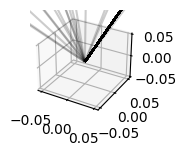

In [ ]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est_flip.shape[0]), np.zeros(v_est_flip.shape[0]), np.zeros(v_est_flip.shape[0]),
            v_est_flip[:, ml], v_est_flip[:, ap], v_est_flip[:, dv], color='k', alpha=0.2)

In [ ]:
ml, ap, dv

(2, 0, 1)

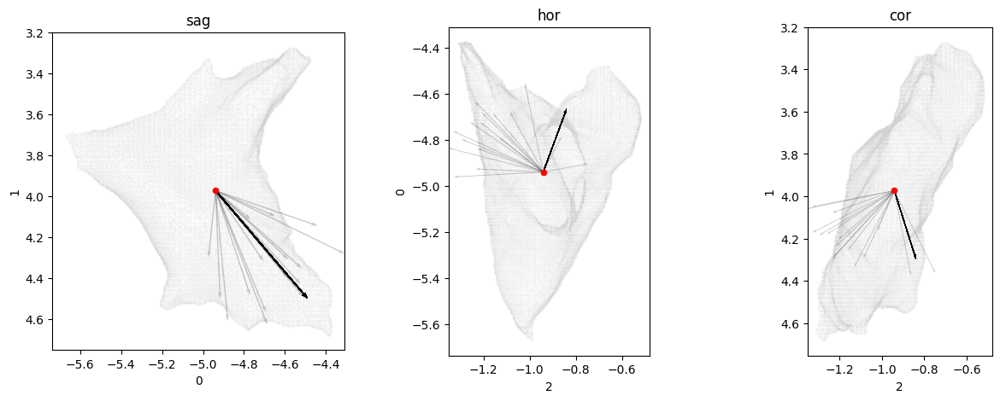

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
midpoints = np.mean(mesh_vertices_mm, axis=0)

for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)

    if planes[plane][1] == dv:
        axes[ind].quiver(midpoints[planes[plane][0]]*np.ones(n_bootstrap), midpoints[planes[plane][1]]*np.ones(n_bootstrap),
                        v_est_flip[:, planes[plane][0]], -v_est_flip[:, planes[plane][1]], color = 'k', alpha=0.2, scale = 2)
    else:
        axes[ind].quiver(midpoints[planes[plane][0]]*np.ones(n_bootstrap), midpoints[planes[plane][1]]*np.ones(n_bootstrap),
                        v_est_flip[:, planes[plane][0]], v_est_flip[:, planes[plane][1]], color = 'k', alpha=0.2, scale = 2)

    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
plt.savefig(fname=os.path.join(wf_folder, 'bs_v_2D.png'))

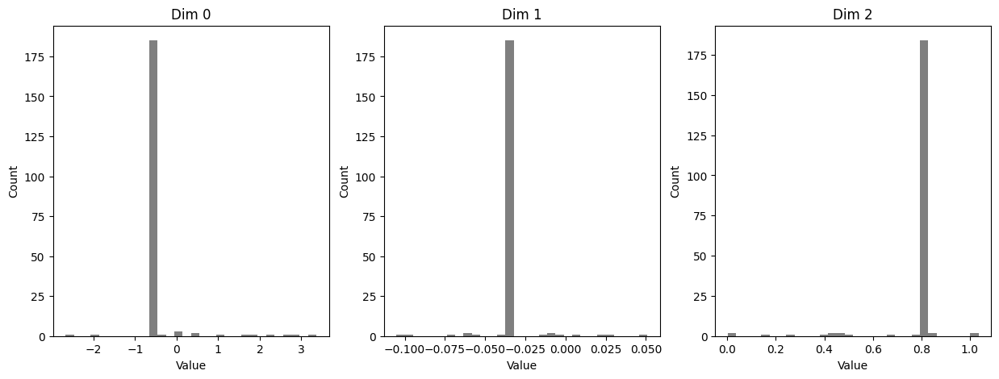

In [ ]:
# histo of w_est_flip
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for ind in range(3):
    axes[ind].hist(w_est_flip[:, ind], bins=30, color='k', alpha=0.5)
    axes[ind].set_title(f'Dim {ind}')
    axes[ind].set_xlabel('Value')
    axes[ind].set_ylabel('Count')


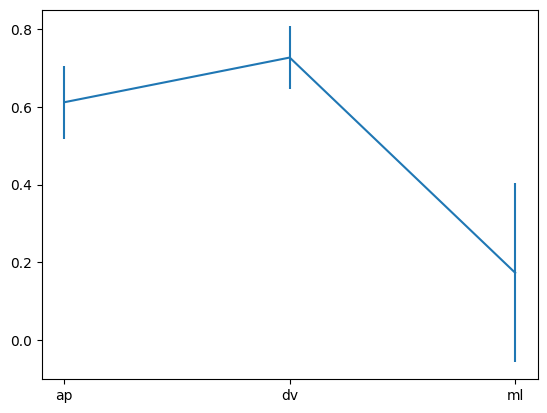

In [ ]:
plt.errorbar(range(3), v_mean, yerr=v_se)
plt.xticks(ticks=range(3), labels=['ap', 'dv', 'ml'])

plt.savefig(fname=os.path.join(wf_folder, 'bs_v_errorbar.png'))

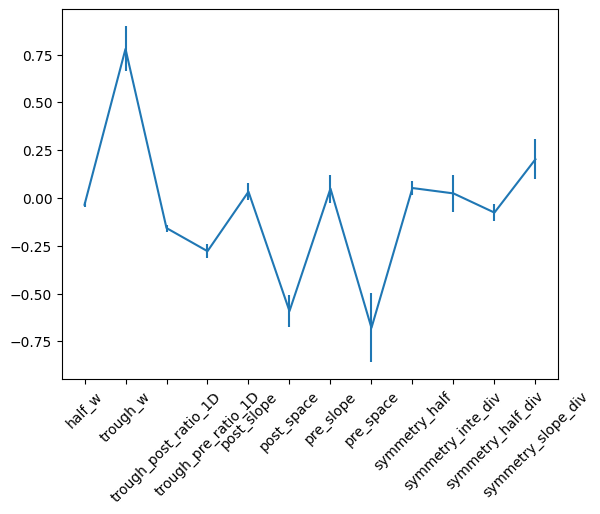

In [ ]:
plt.errorbar(range(len(w_mean)-1), w_mean[1:], yerr = w_se[1:])
plt.xticks(ticks=range(len(w_mean)-1), labels=feature_list[1:], rotation = 45)
plt.savefig(fname=os.path.join(wf_folder, 'bs_w_errorbar.png'))

## Whole sample random seeds

In [ ]:
# P[mask] = zscore(P[mask], axis=0, nan_policy='omit')
v_est = []
w_est = []
res = []
res_corr = []
w_est_corr = []
for ind, seed in enumerate(range(100)):
    v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_orthogonal_space(X_features_zs, P[mask], seed=seed)
    v_est.append(v_est_curr)
    w_est.append(w_est_curr)
    res.append(res_curr)
    res_corr.append(res_corr_curr)
    w_est_corr.append(w_est_corr_curr)

Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.7743697550088788
            Iterations: 106
            Function evaluations: 2546
            Gradient evaluations: 106
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.057077151759669965
            Iterations: 58
            Function evaluations: 1254
            Gradient evaluations: 58

--- Evaluation ---
Estimated w: [-1.89617571e-01  3.38456804e-02 -2.18644787e-06  4.13602936e-02
  1.82023012e-06 -3.80003498e-02 -4.71396959e-04 -2.78595217e-02
 -3.57293918e-02 -1.24597069e-04  1.47950368e-02  4.95999475e-02
 -7.04862360e-02  7.82653259e-06 -1.77697399e-02  3.98176081e-02
  1.08815153e-01  1.85012499e-02  2.82621904e-02 -2.97087683e-02]
Estimated v: [ 0.53613243  0.49294406 -0.68525044]
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.7790995233692577
            Iterations: 81
            Function eva

# Whole sample with fix v_est

In [ ]:
v_est = []
w_est = []
res = []
res_corr = []
w_est_corr = []
for ind, seed in enumerate(range(500)):
    v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_fixed_orthogonal_space(X_features_zs, P[mask], seed=seed)
    v_est.append(v_est_curr)
    w_est.append(w_est_curr)
    res.append(res_curr)
    res_corr.append(res_corr_curr)
    w_est_corr.append(w_est_corr_curr)


--- Evaluation ---
Estimated w: [ 1.18529703e+00  3.04869105e-02  1.99829099e-04  6.23807148e-02
 -1.84816780e-04 -5.84062027e-03  1.23675038e-02 -8.15284927e-02
 -6.18545923e-02 -1.45410445e-02  2.50173063e-02 -6.68332937e-05
 -1.39229228e-01  1.52549568e-05 -4.33191628e-03  4.28371619e-02
  1.50828407e-01  1.06842940e-05  5.43124805e-02 -1.94856409e-02]
Estimated v: [ 0.44137469  0.79373018 -0.41854604]

--- Evaluation ---
Estimated w: [ 1.18530521e+00  1.79986805e-02  3.88182939e-05  6.96043323e-02
  1.36996489e-02 -4.65006250e-02  1.69719515e-02 -5.16365087e-02
 -6.94366502e-02 -7.81148255e-03  2.58547214e-02  4.02746120e-02
 -6.99387481e-02 -5.77154187e-04 -4.33451348e-03  3.93474373e-02
  1.49994411e-01 -3.78742639e-04  5.60557373e-02 -2.34626615e-02]
Estimated v: [ 0.44137469  0.79373018 -0.41854604]

--- Evaluation ---
Estimated w: [ 1.18529321e+00  3.36586017e-02 -1.20395671e-04  6.13498097e-02
  1.67743684e-04 -4.93826299e-02  1.24722263e-02 -4.93578647e-02
 -6.31393671e-02 

In [ ]:
# distribution of v_est, flipped by the sign of the dv dimenstion
corr_max = np.array([-res_corr[i].fun for i in range(len(res_corr))])
dis_min = np.array([np.mean((X_features_zs @ w_est[i]-P[mask]@v_est[i])**2)/np.std(P[mask]@v_est[i]) for i in range(len(res_corr))])
w_corr = np.array([np.corrcoef(w_est[1:], w_est_corr[2:])[0, 1] for i in range(len(res_corr))])
v_est, w_est, w_est_corr = zip(*[(v * np.sign(v[dv]), w * np.sign(v[dv]), w_corr * np.sign(v[dv])) for v, w, w_corr in zip(v_est, w_est, w_est_corr)])
v_est = np.array(v_est)
w_est = np.array(w_est)
w_est_corr = np.array(w_est_corr)

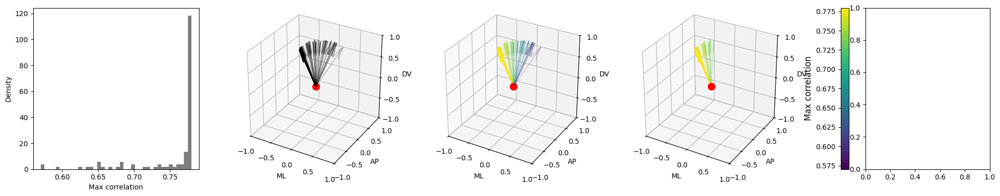

In [ ]:
# max_corr
corr_cutoff = 0.7
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable
fig = plt.figure(figsize=(20, 4))
ax = fig.add_subplot(151)
ax.hist(corr_max, bins=40, color='k', alpha=0.5, density=True)
ax.set_xlabel('Max correlation')
ax.set_ylabel('Density')
# colorcode based on corr_max
colormap = plt.cm.viridis
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')

ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]),
            v_est[:, ml], v_est[:, ap], v_est[:, dv], length=1, normalize=True, color='k', alpha=0.2)
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
# set same aspect ratio
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1

ax = fig.add_subplot(153, projection='3d')
for i in range(len(corr_max)):
    ax.quiver(0, 0, 0,
            v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(154, projection='3d')
for i in range(len(corr_max)):
    if corr_max[i] > corr_cutoff:
        ax.quiver(0, 0, 0,
                v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(155)
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=ax, orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)

plt.tight_layout()

plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

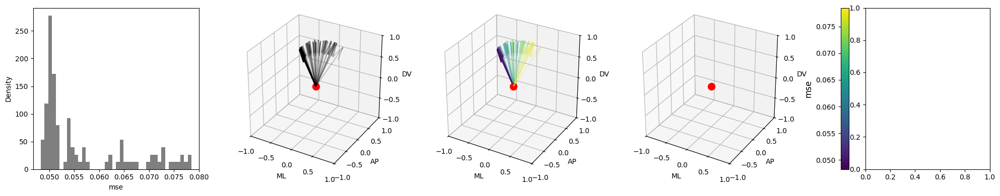

In [ ]:
# min_dis
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable
fig = plt.figure(figsize=(20, 4))
ax = fig.add_subplot(151)
ax.hist(dis_min, bins=40, color='k', alpha=0.5, density=True)
ax.set_xlabel('mse')
ax.set_ylabel('Density')
# colorcode based on corr_max
colormap = plt.cm.viridis
norm = Normalize(vmin=np.min(dis_min), vmax=np.max(dis_min))
cmap = plt.cm.viridis
colors_corr = cmap(norm(dis_min))

colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]),
            v_est[:, ml], v_est[:, ap], v_est[:, dv], length=1, normalize=True, color='k', alpha=0.2)
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
# set same aspect ratio
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1

ax = fig.add_subplot(153, projection='3d')
for i in range(len(dis_min)):
    ax.quiver(0, 0, 0,
            v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(154, projection='3d')
for i in range(len(dis_min)):
    if dis_min[i] > corr_cutoff:
        ax.quiver(0, 0, 0,
                v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(155)
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=ax, orientation='vertical', location = 'left')
cbar.set_label('mse', fontsize=12)

plt.tight_layout()

# plt.savefig(os.path.join(wf_folder, f'v_est_dis_color_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [ ]:

w_est_df = pd.DataFrame(w_est, columns=feature_list)
w_est_df['corr_max'] = corr_max

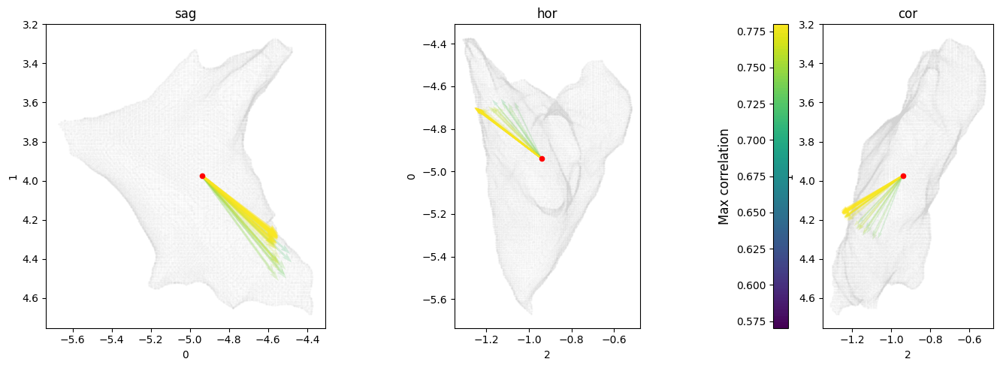

In [ ]:
# plot LC mesh with the vectors
# corr_cutoff = 0
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors
    for i in range(len(corr_max)):
        if corr_max[i] > corr_cutoff:
            if planes[plane][1] == dv:
                axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                                v_est[i, planes[plane][0]]*scale_factor, -v_est[i, planes[plane][1]]*scale_factor, color=colors_corr[i], alpha=0.2, scale = 20)
            else:
                axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                                v_est[i, planes[plane][0]]*scale_factor, v_est[i, planes[plane][1]]*scale_factor, color=colors_corr[i], alpha=0.2, scale = 20)
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_3D_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

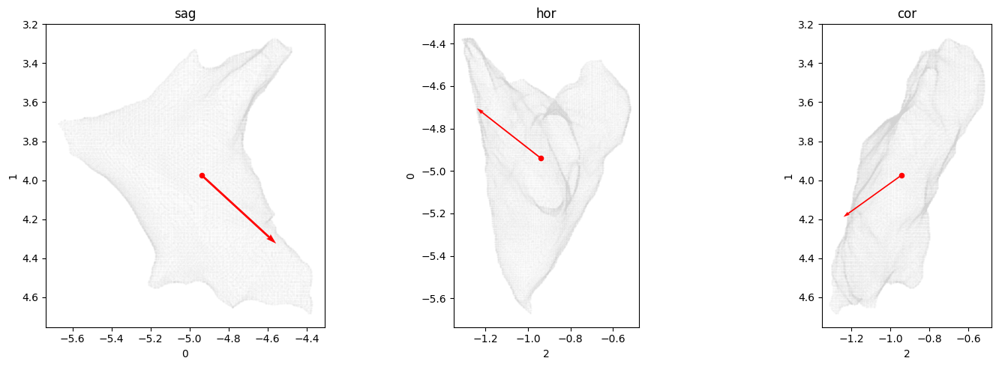

In [ ]:
# plot LC mesh with the the fixed vector
# corr_cutoff = 0
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors

    if planes[plane][1] == dv:
        axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est[0, planes[plane][0]], -v_est[0,planes[plane][1]], color='r', alpha=1, scale = 2)
    else:
        axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est[0, planes[plane][0]], v_est[0, planes[plane][1]], color='r', alpha=1, scale = 2)
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
# cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_3D_{criteria_name}_fixed_v.pdf'), dpi=300, bbox_inches='tight')

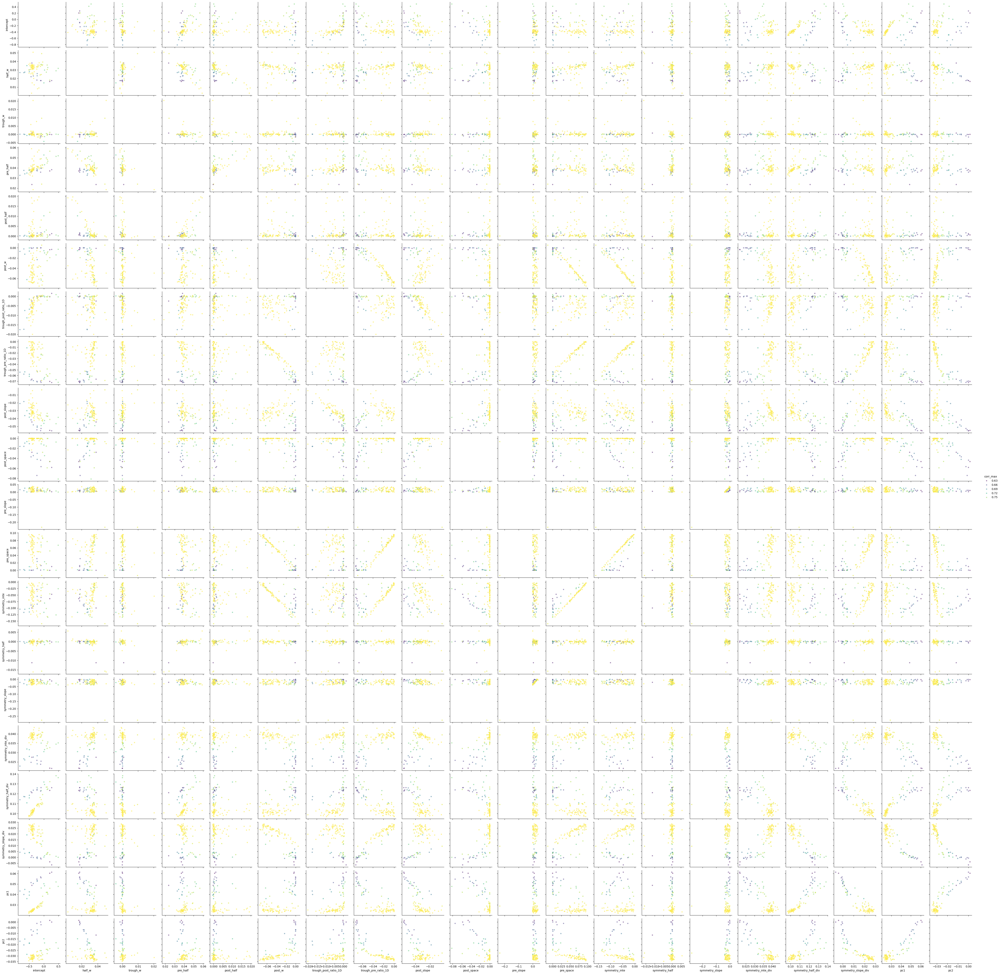

In [ ]:
g = sns.pairplot(data=w_est_df[w_est_df['corr_max']>0.6], hue='corr_max', palette='viridis', plot_kws={'alpha': 0.5, 's': 20})
g.figure.savefig(os.path.join(wf_folder, f'w_est_features_pairplot_{criteria_name}_all.png'), dpi=300)

In [ ]:
cluster_id = np.zeros(len(w_est_df))
w_est_df['cluster_id'] = cluster_id

In [ ]:
# clustering based projection direction and replot weight and projection direction
from sklearn.cluster import KMeans

matrix = zscore(v_est[corr_max>=corr_cutoff], axis=0, nan_policy='omit')
cluster_id = np.full((len(v_est)), np.nan)
# Perform KMeans clustering
kmeans = KMeans(n_clusters=2, random_state=4, n_init='auto')  # Adjust n_init for sklearn >= 1.2
kmeans.fit(matrix)
labels = kmeans.labels_
cluster_id[corr_max>=corr_cutoff] = labels
w_est_df['cluster_id'] = cluster_id


IndexError: list index out of range

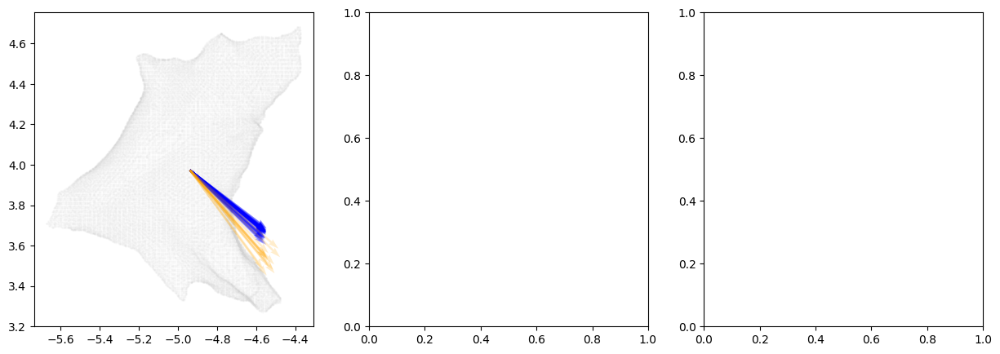

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
colors_cluster = ['blue', 'orange']
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors
    for i in range(len(np.unique(cluster_id))):
        curr_ind = np.where(cluster_id == i)[0]
        if planes[plane][1] == dv:
            axes[ind].quiver(midpoints[planes[plane][0]]*np.ones_like(curr_ind), midpoints[planes[plane][1]]*np.ones_like(curr_ind),
                            v_est[curr_ind, planes[plane][0]], -v_est[curr_ind, planes[plane][1]], color=colors_cluster[i], alpha=0.2, scale = 2, label=f'Cluster {i+1}')
        else:
            axes[ind].quiver(midpoints[planes[plane][0]]*np.ones_like(curr_ind), midpoints[planes[plane][1]]*np.ones_like(curr_ind),
                            v_est[curr_ind, planes[plane][0]], v_est[curr_ind, planes[plane][1]], color=colors_cluster[i], alpha=0.2, scale = 2, label=f'Cluster {i+1}')
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
    if ind == 0:
        axes[ind].legend()
# cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.savefig(os.path.join(wf_folder, f'v_est_cluster_color_3D_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

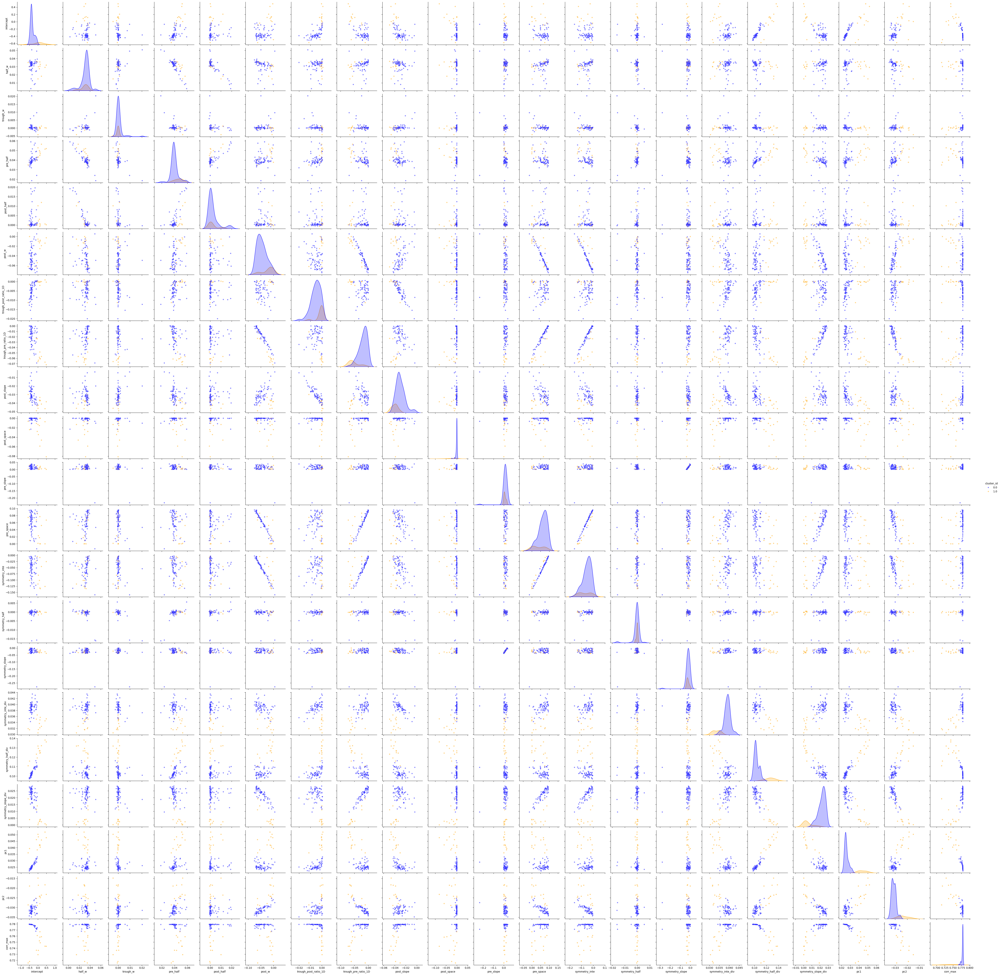

In [ ]:
custom_palette={0: 'blue', 1: 'orange'}
g = sns.pairplot(data=w_est_df[corr_max>corr_cutoff], hue='cluster_id', plot_kws={'alpha': 0.5, 's': 20}, palette=custom_palette)
# limit = [np.nanmin(w_est), np.nanmax(w_est)]
# all_axes = g.axes
# for ind_x in range(len(all_axes)):
#     for ind_y in range(len(all_axes)):
#         ax = all_axes[ind_x, ind_y]
#         if ind_x != ind_y:
#             ax.set_xlim(limit)
#             ax.set_ylim(limit)
#             # Set equal aspect ratio
#             # ax.set_aspect('equal', adjustable='datalim')  # fixed issue with adjustable
#         else:
#             ax.set_xlim(limit)

g.figure.savefig(os.path.join(wf_folder, f'w_est_features_pairplot_cluster_{criteria_name}_all.png'), dpi=300)

/tmp/ipykernel_19379/1637958901.py:10: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='area'` for the same effect.
  g = sns.violinplot(data=df_melted, x='regressor', y='value', hue='cluster_id',


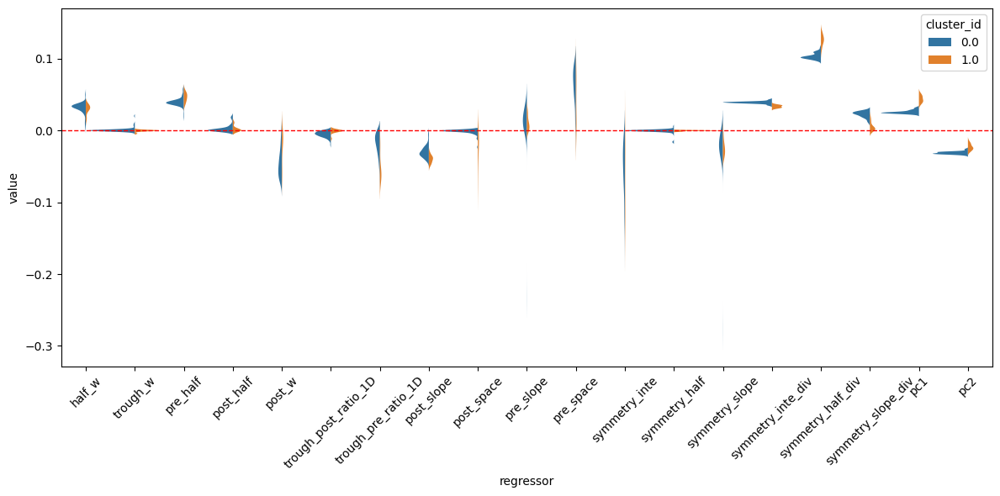

<Figure size 640x480 with 0 Axes>

In [ ]:
# plot the distribution of values in w_est_df for each column as violin plots, separate by cluster
# Example: Assuming w_est_df is your DataFrame and looks like this:
# columns: ['regressor_1', 'regressor_2', ..., 'cluster_id'

# Melt dataframe to long-form
df_melted = w_est_df.drop(['intercept', 'corr_max'], axis = 1).melt(id_vars='cluster_id', var_name='regressor', value_name='value')

# Plot violin plot
plt.figure(figsize=(12, 6))
g = sns.violinplot(data=df_melted, x='regressor', y='value', hue='cluster_id',
               split=True, inner='quartile', scale='area', width=2, linecolor='none')
plt.axhline(y=0, color='r', linestyle='--', linewidth=1)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
plt.savefig(os.path.join(wf_folder, f'w_est_features_violin_plot_cluster_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


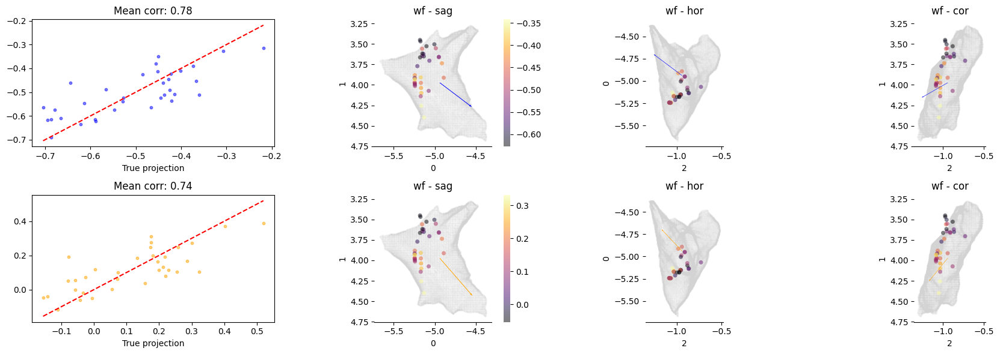

In [ ]:
# plot correlation and colorcode for two clusters
fig = plt.figure(figsize=(18, 6))
gs = plt.GridSpec(2, 4)
for ind, curr_cluster in enumerate(range(len(np.unique(cluster_id))-1)):
    # find the maximum correlation in each cluster
    max_ind = np.argmax(corr_max[cluster_id == curr_cluster])
    w_est_curr = w_est[cluster_id == curr_cluster][max_ind]
    v_est_curr = v_est[cluster_id == curr_cluster][max_ind]
    proj_3D = P[mask] @ v_est_curr
    proj_3D_3D = np.outer(proj_3D, v_est_curr)
    proj_feature = X_features_zs @ w_est_curr
    # plot the correlation
    ax = fig.add_subplot(gs[ind, 0])
    ax.scatter(proj_3D, proj_feature, alpha=0.5, color=colors_cluster[ind], s=10)
    ax.plot([proj_3D.min(), proj_3D.max()],
             [proj_3D.min(), proj_3D.max()], 'r--')
    corr_mean = np.mean(corr_max[cluster_id == curr_cluster])
    ax.set_xlabel('True projection')
    ax.set_title(f'Mean corr: {corr_mean:.2f}')
    norm = Normalize(vmin=np.quantile(proj_feature, 0.05), vmax=np.quantile(proj_feature, 0.95))
    feature_cmap = proj_feature
    feature_cmap[feature_cmap < np.quantile(proj_feature, 0.05)] = np.quantile(proj_feature, 0.05)
    feature_cmap[feature_cmap > np.quantile(proj_feature, 0.95)] = np.quantile(proj_feature, 0.95)

    # in 3D space
    for plane, ax_ind in zip(planes.keys(), range(3)):
        ax = fig.add_subplot(gs[ind, ax_ind+1])
        # Plot the mesh
        ax.scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.05)
        # Plot the points
        sc = ax.scatter(ccfs[mask, planes[plane][0]], ccfs[mask, planes[plane][1]], c= feature_cmap, cmap='inferno', s=25, edgecolor='none', alpha=0.5)

        # plot the projection vector
        if planes[plane][1] == dv:
            ax.quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est_curr[planes[plane][0]], -v_est_curr[planes[plane][1]], color=colors_cluster[ind], alpha=1, scale = 2, width=0.005)
        else:
            ax.quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est_curr[planes[plane][0]], v_est_curr[planes[plane][1]], color=colors_cluster[ind], alpha=1, scale = 2, width=0.005)
        # scatter antidromic 
        anti = combined_tagged_units_filtered[mask]['anti_resp'].values <= 2
        # ax.scatter(ccfs[mask, planes[plane][0]][anti], ccfs[mask, planes[plane][1]][anti], color='none', alpha=1, s = 40, edgecolor='r', linewidth = 1, label='Antidromic')
        ax.set_title(f'{feature} - {plane}')
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        # remove boxes
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # set equal aspect ratio
        ax.set_aspect('equal')
        if planes[plane][1] == dv:
            ax.invert_yaxis()
        if plane == 'sag':
            cbar = fig.colorbar(sc, ax=ax)
            cbar.outline.set_visible(False)
            # cbar.ax.set_visible(False)

plt.tight_layout()

plt.savefig(os.path.join(wf_folder, f'w_v_est_pred_color_2D_{criteria_name}.svg'), dpi=300, bbox_inches='tight')


(array([0., 1., 0., 2., 2., 2., 0., 0., 1., 3., 2., 2., 1., 0., 0., 0., 0.,
        0., 0.]),
 array([3.45120975, 3.50103116, 3.55085257, 3.60067397, 3.65049538,
        3.70031679, 3.7501382 , 3.79995961, 3.84978101, 3.89960242,
        3.94942383, 3.99924524, 4.04906664, 4.09888805, 4.14870946,
        4.19853087, 4.24835228, 4.29817368, 4.34799509, 4.3978165 ]),
 <BarContainer object of 19 artists>)

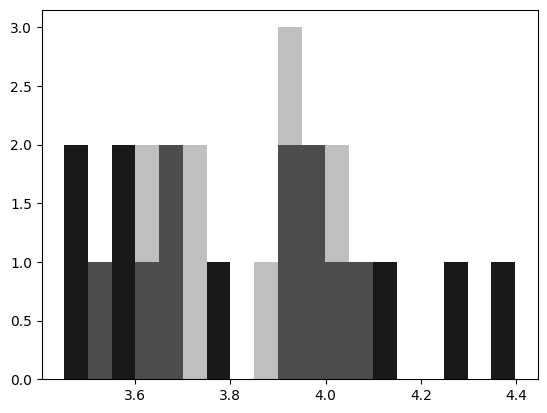

In [ ]:
color1 = 'k'
color2 = 'gray'
bins = np.linspace(np.nanmin(ccfs[:, 1]), np.nanmax(ccfs[:, 1]), 20)
plt.hist(ccfs[clusters==0,1], color = color1, bins = bins, alpha= 0.9)
plt.hist(ccfs[clusters==1,1], color = color2, bins = bins, alpha = 0.5)

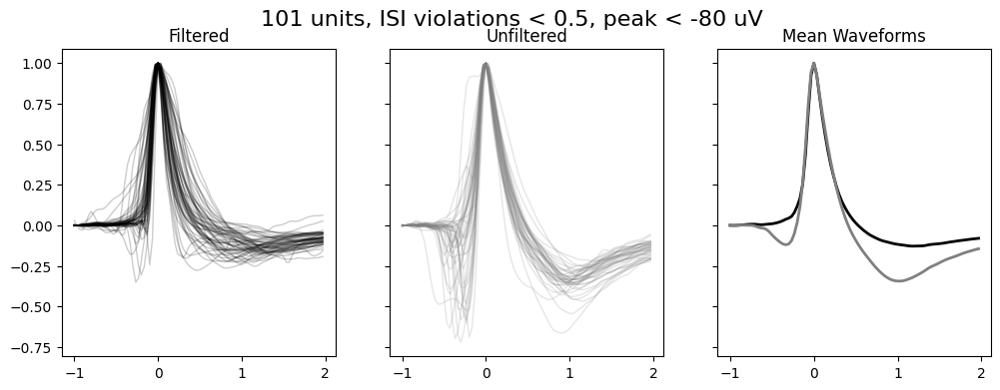

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4), sharey=True)  # sharey links y-axis

wf_time = (np.arange(90) - 30) / 30000 * 1000  # waveform time in ms

# Plot 1: Cluster 1
axs[0].plot(wf_time, all_wfs_nl_clean[clusters==0].T, alpha=0.2, linewidth=1, color=color1)
axs[0].set_title('Filtered')

# Plot 2: Cluster 2
axs[1].plot(wf_time, all_wfs_nl_clean[clusters==1].T, alpha=0.2, linewidth=1, color=color2)
axs[1].set_title('Unfiltered')

# Plot 3: Means
axs[2].plot(wf_time, np.mean(all_wfs_nl_clean[clusters==0], axis=0), linewidth=2, color=color1)
axs[2].plot(wf_time, np.mean(all_wfs_nl_clean[clusters==1], axis=0), linewidth=2, color=color2)
axs[2].set_title('Mean Waveforms')

# Super title
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak_raw']['bounds'][1]} uV"
fig.suptitle(title, fontsize=16)

# Save figure
plt.savefig(os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
# pick max_corr
if len(np.unique(v_est[:,0])) == 1:
    # pick the min distance
    opt_ind = np.argmin(dis_min) 
else:
    opt_ind = np.argmax(corr_max)

w_est_opt = w_est[opt_ind]
v_est_opt = v_est[opt_ind]
proj_3D = P[mask] @ v_est_opt
pred = X_features_zs @ w_est_opt


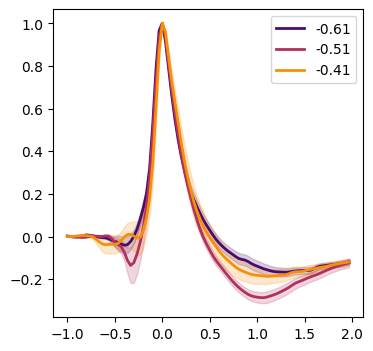

In [ ]:
num_bins = 3
edges = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
# edges = np.linspace(np.min(proj_3D), np.max(proj_3D), num_bins + 1)
# norm = Normalize(vmin=np.quantile(proj_feature, 0.05), vmax=np.quantile(proj_feature, 0.95))
norm = Normalize(vmin=np.min(pred), vmax=np.max(pred))
group_mean = [np.mean(pred[(pred >= edges[ind]) & (pred < edges[ind + 1])]) for ind in range(num_bins)]
colors_groups = plt.cm.inferno(norm(group_mean))
wf_ccf = all_wfs_nl[mask,:]
wf_time = (np.arange(wf_ccf.shape[1]) - 30)*1000/30000

fig, ax = plt.subplots(figsize=(4, 4))

for ind in range(num_bins):
    bin_indices = np.where((pred >= edges[ind]) & (pred < edges[ind + 1]))[0]
    # plot the points in the current bin
    wf_mean = np.nanmean(wf_ccf[bin_indices], axis=0)
    wf_se = np.nanstd(wf_ccf[bin_indices], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[bin_indices]), axis=0))
    ax.plot(wf_time, wf_mean, color=colors_groups[ind], linewidth=2, label=f'{group_mean[ind]:.2f}')
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color=colors_groups[ind], alpha=0.2)
ax.legend()

plt.savefig(os.path.join(wf_folder, f'pred_vs_wf_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
num_bins = 4
edges = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
# edges = np.linspace(np.min(proj_3D), np.max(proj_3D), num_bins + 1)
norm = Normalize(vmin=np.min(pred), vmax=np.max(pred))
group_mean = [np.mean(pred[(pred >= edges[ind]) & (pred < edges[ind + 1])]) for ind in range(num_bins)]
colors_groups = plt.cm.inferno(norm(group_mean))
wf_ccf = all_wfs_aligned_nl[mask,:]
wf_time = (np.arange(wf_ccf.shape[1]) - 30)*1000/30000

fig, axes = plt.subplots(1, num_bins, figsize=(4*num_bins, 4))
wf_lim = [-0.5, 1]
for ind in range(num_bins):
    bin_indices = np.where((pred >= edges[ind]) & (pred < edges[ind + 1]))[0]
    # plot the points in the current bin
    wf_mean = np.nanmean(wf_ccf[bin_indices], axis=0)
    wf_se = np.nanstd(wf_ccf[bin_indices], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[bin_indices]), axis=0))
    ax = axes[ind]
    ax.plot(wf_time, wf_mean, color=colors_groups[ind], linewidth=4)
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color=colors_groups[ind], alpha=0.2)
    ax.set_title(f'{group_mean[ind]:.2f}')
    # turn off the box
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_ylim(wf_lim)

plt.savefig(os.path.join(wf_folder, f'pred_vs_wf_{criteria_name}_all.pdf'), dpi=300, bbox_inches='tight')
    

NameError: name 'all_wfs_aligned_nl' is not defined

In [ ]:
# save wf_ccf
wf_ccf = all_wfs_aligned_nl[mask,:]

np.save(os.path.join(wf_folder, 'waveforms.npy'), wf_ccf)

In [ ]:
len(wf_ccf)

66

<Figure size 800x600 with 0 Axes>

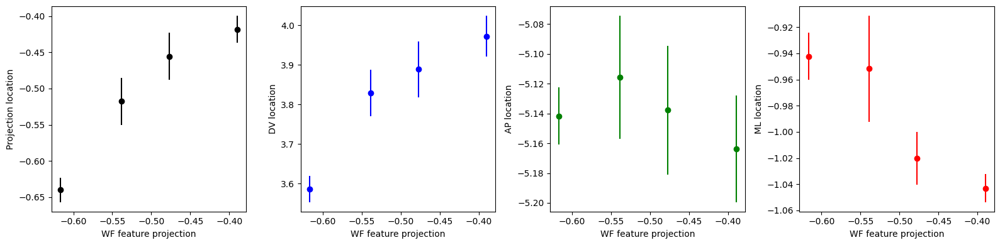

In [ ]:
# Projection number vs waveform feature
plt.figure(figsize=(8, 6))
dv_loc = P[mask][:, dv]
num_bins = 4
edges_proj = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges_proj = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
proj_mean = np.zeros(num_bins)
proj_se = np.zeros(num_bins)
pred_mean = np.zeros(num_bins)
dv_mean = np.zeros(num_bins)
dv_se = np.zeros(num_bins)
ap_mean = np.zeros(num_bins)
ap_se = np.zeros(num_bins)
ml_mean = np.zeros(num_bins)   
ml_se = np.zeros(num_bins)

for ind_bin in range(num_bins):
    bin_indices = np.where((pred >= edges_proj[ind_bin]) & (pred < edges_proj[ind_bin + 1]))[0]
    pred_mean[ind_bin] = np.nanmean(pred[bin_indices])
    proj_mean[ind_bin] = np.nanmean(proj_3D[bin_indices])
    proj_se[ind_bin] = np.nanstd(proj_3D[bin_indices])/np.sqrt(np.sum(~np.isnan(proj_3D[bin_indices]), axis=0))
    dv_mean[ind_bin] = np.nanmean(P[mask][bin_indices, dv])
    dv_se[ind_bin] = np.nanstd(P[mask][bin_indices, dv])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, dv]), axis=0))
    ap_mean[ind_bin] = np.nanmean(P[mask][bin_indices, ap])
    ap_se[ind_bin] = np.nanstd(P[mask][bin_indices, ap])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, ap]), axis=0))
    ml_mean[ind_bin] = np.nanmean(P[mask][bin_indices, ml])
    ml_se[ind_bin] = np.nanstd(P[mask][bin_indices, ml])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, ml]), axis=0))

fig, axes = plt.subplots(1, 4, figsize=(16, 4))
axes[0].errorbar(pred_mean, proj_mean, yerr=proj_se, fmt='o', color='k', label='Projection')
axes[0].set_xlabel('WF feature projection')
axes[0].set_ylabel('Projection location')

axes[1].errorbar(pred_mean, dv_mean, yerr=dv_se, fmt='o', color='b', label='DV')
axes[1].set_xlabel('WF feature projection')
axes[1].set_ylabel('DV location')

axes[2].errorbar(pred_mean, ap_mean, yerr=ap_se, fmt='o', color='g', label='AP')
axes[2].set_xlabel('WF feature projection')
axes[2].set_ylabel('AP location')

axes[3].errorbar(pred_mean, ml_mean, yerr=ml_se, fmt='o', color='r', label='ML')
axes[3].set_xlabel('WF feature projection')
axes[3].set_ylabel('ML location')

plt.tight_layout()

fig.savefig(os.path.join(wf_folder, f'projection_vs_location_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


    

In [ ]:
# save data
wf_features_ccf = wf_features[mask].copy()
wf_features_ccf.reset_index(drop=True, inplace=True)
wf_features_ccf['proj'] = proj_3D
wf_features_ccf['feature_pred'] = pred
wf_features_ccf['ccf'] = list(P[mask])
wf_features_ccf['wf_nl'] = list(all_wfs_aligned_nl[mask,:])

# save wf_features_ccf, w_est_opt, v_est_opt, corr_max in a single pickle file
data = {}
data['wf_df'] = wf_features_ccf
data['w_est'] = w_est_opt
data['v_est'] = v_est_opt
data['corr_max'] = corr_max
data['ccf'] = P[mask]
data['wf_nl'] = all_wfs_aligned_nl[mask,:]
with open(os.path.join(wf_folder, f'projection_data_{criteria_name}.pkl'), 'wb') as f:
    pickle.dump(data, f)


In [ ]:
# find antidromic neurons
len(combined_tagged_units_filtered), len(wf_features_ccf)

(167, 66)

In [ ]:
combined_tagged_units_filtered[mask]['anti_resp'].values

array([nan,  3., nan,  3.,  3., nan, nan, nan, nan, nan, nan, nan,  2.,
        3., nan, nan, nan, nan,  2., nan, nan, nan, nan, nan, nan, nan,
        3., nan, nan, nan, nan, nan, nan, nan,  2.,  2., nan, nan, nan,
       nan, nan, nan,  3., nan, nan, nan, nan,  3., nan, nan, nan,  2.,
        2.,  2., nan,  1., nan,  1.,  2., nan, nan, nan,  2.,  1.,  2.,
        1.])

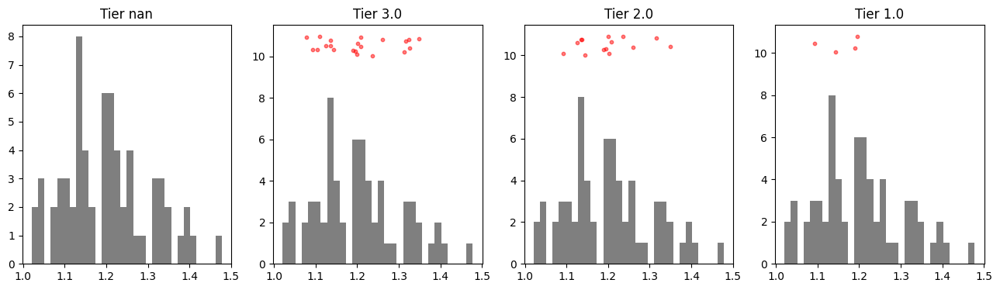

In [ ]:
fig, axes = plt.subplots(1, len(combined_tagged_units_filtered[mask]['anti_resp'].unique()), figsize=(16, 4))
for ind, tier in enumerate(combined_tagged_units_filtered[mask]['anti_resp'].unique()):
    ax = axes[ind]
    ax.hist(wf_features_ccf['feature_pred'], bins=30, color='k', alpha=0.5)
    ax.scatter(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]['feature_pred'], np.random.rand(len(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier])) + 10, color='r', alpha=0.5, s=10, label=f'{tier} ms')
    ax.set_title(f'Tier {tier}')

/opt/conda/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/conda/lib/python3.10/site-packages/numpy/_core/_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_12774/598732996.py:7: RuntimeWarning: Mean of empty slice
  wf_mean = np.nanmean(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)
/opt/conda/lib/python3.10/site-packages/numpy/lib/_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


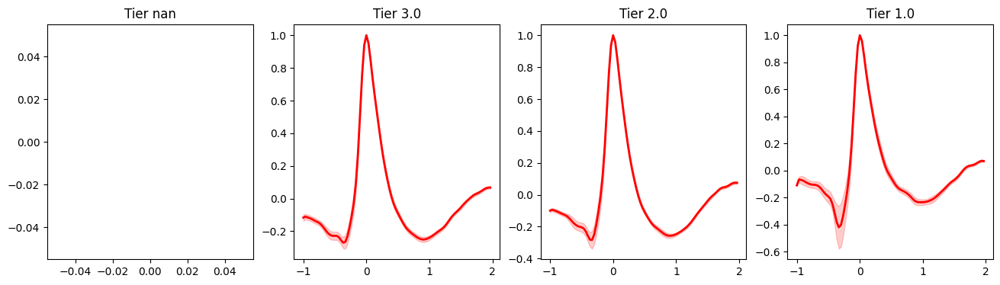

In [ ]:
# mean wf for each tier
fig, axes = plt.subplots(1, len(combined_tagged_units_filtered[mask]['anti_resp'].unique()), figsize=(16, 4))
for ind, tier in enumerate(combined_tagged_units_filtered[mask]['anti_resp'].unique()):
    ax = axes[ind]
    group_mean = np.mean(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]['feature_pred'].values)
    colors_group = plt.cm.viridis(norm(group_mean))
    wf_mean = np.nanmean(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)
    wf_se = np.nanstd(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]), axis=0))
    ax.plot(wf_time, wf_mean, color='r', linewidth=2, label=f'{tier} ms')
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color='r', alpha=0.2)
    ax.set_title(f'Tier {tier}')
fig.savefig(os.path.join(wf_folder, f'anti_resp_tiers.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
# # grab all tagged units and combine a pdf
# data_type = 'curated'
# target = 'soma'
# selected_sessions = []
# selected_units = []
# all_pdf = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         session_dir = session_dirs(session)
#         # # opto_file
#         # all_pdfs = os.listdir(session_dir[f'opto_dir_fig_{data_type}'])
#         # pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         # pdf_path = os.path.join(session_dir[f'opto_dir_fig_{data_type}'], pdf)
#         # # copy to new path
#         # new_path_opto = os.path.join('/root/capsule/scratch/combined/opto_tagged', f'{session}_{pdf}')
#         # _ = shutil.copy(pdf_path, new_path_opto)

#         # selected_sessions.append(session)
#         # selected_units.append(unit)
#         # all_pdf.append(pdf_path)

#         # # behavior file: go cue
#         # all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue'))
#         # pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         # pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue', pdf)
#         # # copy to new path
#         # new_path_ephys = os.path.join('/root/capsule/scratch/combined/behavior_tagged_go_cue', f'{session}_{pdf}')
#         # _ = shutil.copy(pdf_path, new_path_ephys)

#         # behavior file: go cue
#         all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response'))
#         pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response', pdf)
#         # copy to new path
#         new_path_ephys = os.path.join('/root/capsule/scratch/combined/behavior_tagged_response', f'{session}_{pdf}')
#         _ = shutil.copy(pdf_path, new_path_ephys)


In [ ]:
# opto_sessions = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         opto_sessions.append(session)

# opto_sessions = list(set(opto_sessions))

# for session in opto_sessions:
#     session_dir = session_dirs(session)
#     opto_summary_file = os.path.join(session_dir[f'opto_dir_{data_type}'], f"{session}_{data_type}_{target}_opto_summary.pdf")
#     if os.path.exists(opto_summary_file):
#         new_path = os.path.join('/root/capsule/scratch/combined/opto_summary', f'{session}_opto_summary.pdf')
#         _ = shutil.copy(opto_summary_file, new_path)


In [ ]:
# opto_sessions = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         opto_sessions.append(session)

# opto_sessions = list(set(opto_sessions))

# for session in opto_sessions:
#     session_dir = session_dirs(session)
#     waveform_summary_file = os.path.join(session_dir[f'ephys_dir_{data_type}'], "waveforms_recompute.pdf")
#     if os.path.exists(waveform_summary_file):
#         new_path = os.path.join('/root/capsule/scratch/combined/waveform_summary', f'{session}_waveform_recompute.pdf')
#         _ = shutil.copy(waveform_summary_file, new_path)

In [ ]:
# # combine_pdf_big('/root/capsule/scratch/combined/opto_tagged', os.path.join('/root/capsule/scratch/combined', 'opto_tagged_combined.pdf'))
# # combine_pdf_big('/root/capsule/scratch/combined/behavior_tagged_go_cue', os.path.join('/root/capsule/scratch/combined', 'behavior_ephys_tagged_go_cue_combined.pdf'))

# # combine_pdf_big('/root/capsule/scratch/combined/behavior_tagged_response', os.path.join('/root/capsule/scratch/combined', 'behavior_ephys_tagged_response_combined.pdf'))
# combine_pdf_big('/root/capsule/scratch/combined/opto_summary', os.path.join('/root/capsule/scratch/combined', 'opto_probe_summary.pdf'))